## Importing Libraries

In [10]:
import pandas as pd #Library to handle with dataframes
import matplotlib.pyplot as plt # Library to plot graphics
import numpy as np # To handle with matrices
import seaborn as sns # to build modern graphics
from scipy.stats import kurtosis, skew # it's to explore some statistics of numerical values
from scipy import stats
import re

In [11]:
import sklearn

sklearn.__version__

'0.21.3'


## Functions def

In [12]:
def resumetable(df):
    print(f"Dataset Shape: {df.shape}")
    summary = pd.DataFrame(df.dtypes,columns=['dtypes'])
    summary = summary.reset_index()
    summary['Name'] = summary['index']
    summary = summary[['Name','dtypes']]
    summary['Missing'] = df.isnull().sum().values    
    summary['Uniques'] = df.nunique().values
    summary['First Value'] = df.loc[0].values
    summary['Second Value'] = df.loc[1].values
    summary['Third Value'] = df.loc[2].values

    for name in summary['Name'].value_counts().index:
        summary.loc[summary['Name'] == name, 'Entropy'] = round(stats.entropy(df[name].value_counts(normalize=True), base=2),2) 

    return summary

def CalcOutliers(df_num): 
    '''
    
    Leonardo Ferreira 20/10/2018
    Set a numerical value and it will calculate the upper, lower and total number of outliers
    It will print a lot of statistics of the numerical feature that you set on input
    
    '''
    # calculating mean and std of the array
    data_mean, data_std = np.mean(df_num), np.std(df_num)

    # seting the cut line to both higher and lower values
    # You can change this value
    cut = data_std * 3

    #Calculating the higher and lower cut values
    lower, upper = data_mean - cut, data_mean + cut

    # creating an array of lower, higher and total outlier values 
    outliers_lower = [x for x in df_num if x < lower]
    outliers_higher = [x for x in df_num if x > upper]
    outliers_total = [x for x in df_num if x < lower or x > upper]

    # array without outlier values
    outliers_removed = [x for x in df_num if x > lower and x < upper]
    
    print('Identified lowest outliers: %d' % len(outliers_lower)) # printing total number of values in lower cut of outliers
    print('Identified upper outliers: %d' % len(outliers_higher)) # printing total number of values in higher cut of outliers
    print('Identified outliers: %d' % len(outliers_total)) # printing total number of values outliers of both sides
    print('Non-outlier observations: %d' % len(outliers_removed)) # printing total number of non outlier values
    print("Total percentual of Outliers: ", round((len(outliers_total) / len(outliers_removed) )*100, 4)) # Percentual of outliers in points
    
    return

def remove_year(year):
    #years= year.str.extract(r'([0-9]{4})')
    expr= re.compile('[0-9]{4}')
    line = re.sub(expr, '', year) 
    return line

In [13]:
# Importing our dataset in variable df_wine1
df_wine1 = pd.read_csv('data/winemag-data-130k-v2.csv', index_col=0)

In [14]:
df_wine1['harvest'] = df_wine1['title'].str.extract(r'([0-9]{4})')
df_wine1.title = df_wine1.title.apply(remove_year)
df_wine1['harvest'].fillna(0, inplace=True)
df_wine1['harvest'] = df_wine1['harvest'].astype(float)


In [15]:
df_wine1.title = df_wine1.title.apply(remove_year)

In [16]:
resumetable(df_wine1)

Dataset Shape: (129971, 14)


,Name,dtypes,Missing,Uniques,First Value,Second Value,Third Value,Entropy
0,country,object,63,43,Italy,Portugal,US,2.77
1,description,object,0,119955,"Aromas include tropical fruit, broom, brimston...","This is ripe and fruity, a wine that is smooth...","Tart and snappy, the flavors of lime flesh and...",16.83
2,designation,object,37465,37979,Vulkà Bianco,Avidagos,NaN,13.83
3,points,int64,0,21,87,87,87,3.64
4,price,float64,8996,390,NaN,15,14,5.77
5,province,object,63,425,Sicily & Sardinia,Douro,Oregon,5.05
6,region_1,object,21247,1229,Etna,NaN,Willamette Valley,7.89
7,region_2,object,79460,17,NaN,NaN,Willamette Valley,3.28
8,taster_name,object,26244,19,Kerin O’Keefe,Roger Voss,Paul Gregutt,3.39
9,taster_twitter_handle,object,31213,15,@kerinokeefe,@vossroger,@paulgwine,3.23


In [17]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
from sklearn import preprocessing, decomposition, model_selection, metrics, pipeline
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.cluster import KMeans
import nltk
from nltk.stem.wordnet import WordNetLemmatizer


In [18]:

from nltk.corpus import stopwords
stop_words = set(stopwords.words("english"))

# stop_words.update(['drink', 'fruit', 'wine', 'ready', ])

#create a list of stop words
#stop_words = set(stopwords.words("english"))
#show how many words are in the list of stop words
#print(len(stopwords))
#179
#construct a new list to store the cleaned text
clean_desc = []
for w in range(len(df_wine1.description)):
    
    desc = df_wine1['description'][w].lower()
    
    #remove punctuation
    desc = re.sub('[^a-zA-Z]', ' ', desc)
    
    #remove tags
    desc = re.sub("&lt;/?.*?&gt;"," &lt;&gt; ",desc)
    
    #remove special characters and digits
    desc = re.sub("(\\d|\\W)+"," ",desc)
    
    split_text = desc.split()
    
    #Lemmatisation
    lem = WordNetLemmatizer()
    split_text = [lem.lemmatize(word) for word in split_text if not word in stop_words and len(word) >2] 
    split_text = " ".join(split_text)
    clean_desc.append(split_text)
    
df_wine1['description_desc'] = clean_desc
# df_wine1.drop('description', axis=1, inplace=True)
df_wine1 = df_wine1[(df_wine1.harvest >= int(2004)) & (df_wine1.harvest <= 2015)]
del clean_desc

In [19]:
resumetable(df_wine1)

Dataset Shape: (117350, 15)


,Name,dtypes,Missing,Uniques,First Value,Second Value,Third Value,Entropy
0,country,object,53,43,Italy,Portugal,US,2.74
1,description,object,0,108122,"Aromas include tropical fruit, broom, brimston...","This is ripe and fruity, a wine that is smooth...","Tart and snappy, the flavors of lime flesh and...",16.68
2,designation,object,34602,34149,Vulkà Bianco,Avidagos,NaN,13.74
3,points,int64,0,21,87,87,87,3.64
4,price,float64,8131,375,NaN,15,14,5.78
5,province,object,53,406,Sicily & Sardinia,Douro,Oregon,4.95
6,region_1,object,19027,1190,Etna,NaN,Willamette Valley,7.84
7,region_2,object,70191,17,NaN,NaN,Willamette Valley,3.25
8,taster_name,object,23022,19,Kerin O’Keefe,Roger Voss,Paul Gregutt,3.41
9,taster_twitter_handle,object,27658,15,@kerinokeefe,@vossroger,@paulgwine,3.25


In [20]:
df_wine1.columns

Index(['country', 'description', 'designation', 'points', 'price', 'province',
       'region_1', 'region_2', 'taster_name', 'taster_twitter_handle', 'title',
       'variety', 'winery', 'harvest', 'description_desc'],
      dtype='object')

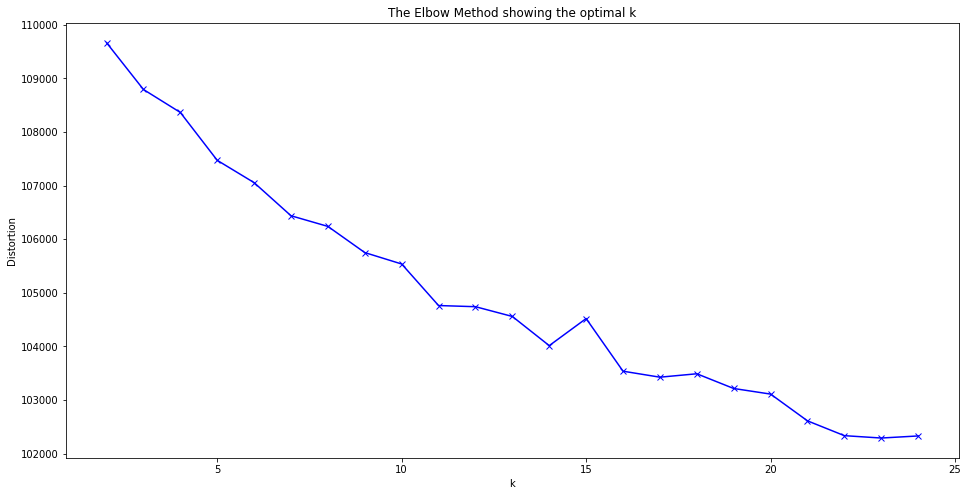

In [21]:
from sklearn.cluster import MiniBatchKMeans
from sklearn.decomposition import PCA, TruncatedSVD
import time

#TF-IDF vectorizer
tfv = TfidfVectorizer(stop_words = stop_words, ngram_range = (1,3), max_features=600)
#transform
vec_text = tfv.fit_transform(df_wine1['description_desc'])
#returns a list of words.
words = tfv.get_feature_names()

# from sklearn.cluster import KMeans

distortions = []
K = range(2,25)
for k in K:
    kmeanModel = MiniBatchKMeans(n_clusters=k)
    kmeanModel.fit(vec_text)
    distortions.append(kmeanModel.inertia_)

plt.figure(figsize=(16,8))
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()


In [22]:
kmeans = pd.DataFrame(data={'K_number':K, 'Distorcions':distortions})
kmeans.to_csv('data/elbow_method.csv')




In [33]:
fig = px.scatter(kmeans, x='K_number', y='Distorcions')

number = 6
fig.add_scatter(x=number, y=''color='red'
    
)

ValueError: 
    Invalid value of type 'builtins.int' received for the 'x' property of scatter
        Received value: 6

    The 'x' property is an array that may be specified as a tuple,
    list, numpy array, or pandas Series

In [105]:
df_wine1['clusters'] = df_wine1['clusters'].astype(str)

fig = px.parallel_categories(df_wine1, 
                             dimensions=['variety','country'],
                             dimensions_max_cardinality=20
                 )
fig.show()

In [117]:
df['cluster'] = 'oi'

In [118]:
df

,cluster


In [150]:
%%time

for i in range(2, 25):
    
    kmeanModel = MiniBatchKMeans(n_clusters=i, random_state=42)

    kmeanModel.fit(vec_text)

    df_wine1['clusters'] = kmeanModel.predict(vec_text)

    groupby = df_wine1.clusters.value_counts().reset_index().rename(columns={'clusters':'total_reviews',
                                                                             'index':'clusters' })
    groupby.to_csv(f"data/clusters/count_clusters{i}.csv")
    
    #this loop transforms the numbers back into words
    common_words = kmeanModel.cluster_centers_.argsort()[:,-1:-11:-1]
    
    df = pd.DataFrame()

    crosst = pd.crosstab(df_wine1['clusters'], df_wine1['country'], normalize='index').unstack('clusters').reset_index()
    crosst = crosst.rename(columns={0:'total'})
    crosst.total = round(crosst.total, 2)
    crosst.to_csv(f"data/clusters/crosstab_country{i}.csv")
    
    for num, centroid in enumerate(common_words):
#         print(#str(num) + ' : ' + 
#               ', '.join(words[word] for word in centroid))
        tmp = pd.DataFrame({'cluster':num, 'common_words':[', '.join(words[word] for word in centroid)]})
        df = pd.concat([df, tmp])

        df.to_csv(f"data/clusters/clusters{i}.csv")
        

CPU times: user 19.3 s, sys: 15.7 ms, total: 19.3 s
Wall time: 19.3 s


In [56]:
import plotly_express as px

test = pd.crosstab(df_wine1['clusters'], df_wine1['country'], normalize='index').unstack('clusters').reset_index().rename(columns={0:'total'})
test.total = round(test.total * 100,2)

In [60]:
for i in df_wine1['clusters'].unique():
    print(i)
    for n in range(2,10):
        norm_sum = test[test['clusters'] == i].sort_values('total', ascending=False)[:n]['total'].sum()
        print(norm_sum)
#         if norm_sum > 80.00:
#             test[test['clusters'] == 1].sort_values('total', ascending=False)[:8]
            

17
99.3
99.5
99.66
99.78
99.82000000000001
99.86000000000001
99.89999999999999
99.94
6
80.0
91.0
94.83
97.92
98.51
98.89
99.25
99.45
23
69.67999999999999
75.75
80.16
84.47
87.31
89.96000000000001
92.02
93.83999999999999
12
70.92999999999999
76.49
81.36
85.06
88.06
90.81
93.11999999999999
95.05
8
79.21000000000001
84.91000000000001
88.52000000000001
91.87
94.9
96.28
97.15
97.89
16
78.22
86.61
90.36
92.03
93.4
94.62
95.8
96.86
22
80.55000000000001
90.97000000000001
93.65000000000002
95.49000000000002
96.94000000000003
97.89000000000003
98.45
98.9
5
55.209999999999994
68.50999999999999
79.66
84.67
86.85000000000001
89.03000000000002
91.16
93.14999999999999
2
58.260000000000005
67.7
76.31
82.38
86.72999999999999
90.19999999999999
92.47
94.59
15
71.52000000000001
77.94000000000001
81.94000000000001
84.92000000000002
87.66000000000001
90.39000000000001
93.11000000000001
95.51000000000002
9
78.41
87.64
93.93
97.83000000000001
98.36000000000001
98.73000000000002
99.1
99.33
11
72.48
77.34
81.28

In [136]:
px.bar(test, x='clusters', y='total', color='country')

In [153]:
test

,country,clusters,total
0,Argentina,0,1.12
1,Argentina,1,0.03
2,Argentina,2,2.27
3,Argentina,3,0.16
4,Argentina,4,25.25
5,Others,5,1.99
6,Argentina,6,0.20
7,Argentina,7,1.45
8,Argentina,8,3.61
9,Argentina,9,0.07


In [141]:
px.bar(test[test.clusters == 5], x='clusters', y='total', color='country')

In [45]:
fig = px.sunburst(test, path=['clusters', 'country', 'total'], 
                  values='total', height=700, maxdepth=2)

NameError: name 'px' is not defined

In [61]:
df_wine1['country'].value_counts()

US                        50799
France                    18949
Italy                     17412
Spain                      5737
Portugal                   4925
Chile                      4033
Argentina                  3600
Austria                    3022
Germany                    2095
Australia                  1946
New Zealand                1249
South Africa               1228
Israel                      483
Greece                      428
Canada                      234
Bulgaria                    136
Hungary                     123
Romania                     108
Uruguay                      99
Turkey                       90
Slovenia                     85
Georgia                      81
Croatia                      72
Mexico                       65
England                      59
Moldova                      56
Brazil                       36
Lebanon                      30
Morocco                      26
Peru                         16
Serbia                       12
Macedoni

In [27]:
px.bar(groupby, x="clusters",
                      y="total_reviews",
                      title="Elbow Method Runs").update_layout(xaxis=dict(type='category', 
                                                                          categoryarray= [x for x in sorted(groupby['clusters'])]))


In [132]:
df

,cluster,common_words
0,0,"black, cherry, tannin, black cherry, palate, c..."
0,1,"flavor, cherry, finish, wine, fruit, aroma, be..."
0,2,"apple, flavor, lemon, peach, citrus, palate, w..."
0,3,"wine, fruit, drink, acidity, ripe, tannin, ric..."


In [84]:
df_wine1.clusters.value_counts().sort_index()

0    20066
1    23174
2    41219
3    12637
4    20254
Name: clusters, dtype: int64

In [91]:
cluster_0 = ['wine', 'fruit', 'drink', 'acidity', 'ripe', 'tannin', 'rich', 'character', 'wood', 'fruity']

In [90]:
pd.crosstab(df_wine1['variety'], df_wine1['clusters']).T.reset_index()

variety,clusters,Abouriou,Agiorgitiko,Aglianico,Aidani,Airen,Albana,Albanello,Albariño,Albarossa,...,Yapincak,Zelen,Zibibbo,Zierfandler,Zierfandler-Rotgipfler,Zinfandel,Zlahtina,Zweigelt,Çalkarası,Žilavka
0,0,2,2,6,0,0,0,0,0,0,...,0,0,0,4,0,83,0,62,0,0
1,1,0,33,220,0,0,0,0,1,0,...,0,0,1,0,0,297,0,37,0,0
2,2,1,26,104,0,1,0,0,6,2,...,0,0,0,0,0,2121,0,96,1,0
3,3,0,0,1,0,1,3,0,196,0,...,1,0,0,9,4,0,0,6,0,0
4,4,0,0,7,1,1,19,1,226,0,...,1,1,29,2,0,14,2,3,1,1


In [55]:
resumetable(df_wine1)

Dataset Shape: (117350, 16)


,Name,dtypes,Missing,Uniques,First Value,Second Value,Third Value,Entropy
0,country,object,53,43,Italy,Portugal,US,2.74
1,description,object,0,108122,"Aromas include tropical fruit, broom, brimston...","This is ripe and fruity, a wine that is smooth...","Tart and snappy, the flavors of lime flesh and...",16.68
2,designation,object,34602,34149,Vulkà Bianco,Avidagos,NaN,13.74
3,points,int64,0,21,87,87,87,3.64
4,price,float64,8131,375,NaN,15,14,5.78
5,province,object,53,406,Sicily & Sardinia,Douro,Oregon,4.95
6,region_1,object,19027,1190,Etna,NaN,Willamette Valley,7.84
7,region_2,object,70191,17,NaN,NaN,Willamette Valley,3.25
8,taster_name,object,23022,19,Kerin O’Keefe,Roger Voss,Paul Gregutt,3.41
9,taster_twitter_handle,object,27658,15,@kerinokeefe,@vossroger,@paulgwine,3.25


In [ ]:
df_wine1[['description_desc', 'aspects']]

In [56]:
SVD = TruncatedSVD(n_components=2, n_iter=30, random_state=42)

principalComponents = SVD.fit_transform(vec_text)

principalDf = pd.DataFrame(principalComponents)

# df.drop(cols, axis=1, inplace=True)
prefix='Target_PCA'
principalDf.rename(columns=lambda x: str(prefix)+str(x), inplace=True)


In [70]:
df_wine1.reset_index(drop=True, inplace=True)

In [71]:
%%time
for i in range(len(principalComponents)):
    df_wine1.loc[i, 'PCA0_target'] = principalComponents[i][0]
    df_wine1.loc[i, 'PCA1_target'] = principalComponents[i][1]

CPU times: user 1min 24s, sys: 0 ns, total: 1min 24s
Wall time: 1min 24s


In [76]:
resumetable(df_wine1)

Dataset Shape: (117350, 19)


TypeError: ("unhashable type: 'list'", 'occurred at index aspects')

In [74]:
import random

df_wine1[df_wine1['title'] == 'Red (California)']['winery'].values[random.randint(0, len(df_wine1[df_wine1['title'] == 'Red (California)']['winery']))]

'Mad Crush'

In [221]:
df_wine1['price'].mean()

35.93218212948297

In [222]:
df_wine1['points'].mean()

88.53304644226672

In [84]:
df_wine1['province'].isin(['Oregon'])

0         False
1         False
2          True
3         False
4          True
          ...  
117345    False
117346     True
117347    False
117348    False
117349    False
Name: province, Length: 117350, dtype: bool

In [85]:
df_wine1.columns

Index(['country', 'description', 'designation', 'points', 'price', 'province',
       'region_1', 'region_2', 'taster_name', 'taster_twitter_handle', 'title',
       'variety', 'winery', 'harvest', 'description_desc', 'clusters',
       'aspects', 'rating_cat'],
      dtype='object')

In [137]:
sentiment.harvest.head()

0    2013.0
1    2011.0
2    2013.0
3    2013.0
4    2012.0
Name: harvest, dtype: float64

In [143]:
sentiment['rating_cat'] = df_wine1.rating_cat

In [144]:

sentiment.harvest = sentiment.harvest.astype(int)
sentiment.to_csv("data/wine_data_new.csv")

In [29]:
len(df_wine1.description)

117350

In [90]:
f = {'price':['mean'], 'points':['mean'], 'winery':['nunique'], 'description':['count']}

t = df_wine1.groupby(['country', 'variety', 'harvest', 'rating_cat']).agg(f)
t.columns = t.columns.map('_'.join).to_series()
t = t.reset_index().rename(columns={'price_mean':'price', 'points_mean':'points', 'year':'harvest',
                                    'winery_nunique':'wineries', 'description_count':'reviews'})
# t['clusters'] = t['clusters'].astype(str)
t.to_csv('data/matrix_wines.csv')

In [255]:
px.histogram(df_wine1[(df_wine1['country'] =='Portugal')], x='points')

In [256]:
px.histogram(df_wine1[(df_wine1['country'] =='Portugal')], x='price', log_x=True)

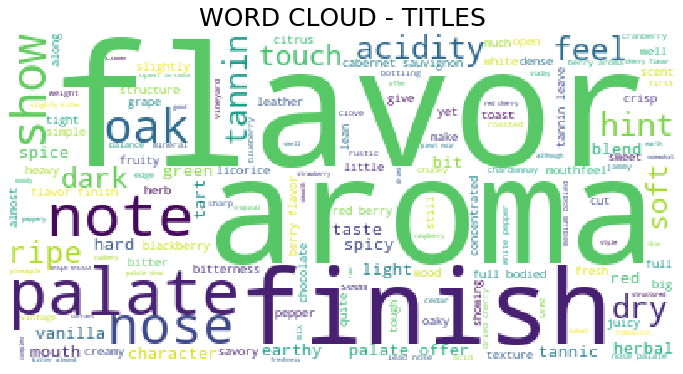

In [294]:
from wordcloud import WordCloud, STOPWORDS

stopwords = set(STOPWORDS)

newStopWords = ['fruit', "Drink", "black", 'wine', 'drink']

stopwords.update(newStopWords)

wordcloud = WordCloud(
    background_color='white',
    stopwords=stopwords,
    max_words=150,
    max_font_size=100, 
    width=400, height=200,
    random_state=42,
).generate(" ".join(sentiment[sentiment.sentiment == 'NEGATIVE']['description_desc'].astype(str)))


fig = plt.figure(figsize = (12,14))
plt.imshow(wordcloud)
plt.title("WORD CLOUD - TITLES",fontsize=25)
plt.axis('off')
plt.show()

In [354]:
df_wine1[(df_wine1['country'] =='Portugal')]['description_desc'][3:4].values

array(['estate south alentejo rich hot country wine firm densely structured solid dark tannin juicy black fruit background dense wine give lift still young dark concentrated wine better'],
      dtype=object)

In [343]:
df_wine1[(df_wine1['country'] =='Portugal')]['aspects']

1                 [acidity, wine, firm, fruity, tannin]
79                    [fruit, wine, tejo, grape, drink]
151           [wine, fruit, flavor, charge, generation]
157                   [wine, fruit, firm, tannin, lift]
203       [currant, year, wine, texture, concentration]
                              ...                      
129863       [wine, edge, firm, texture, concentration]
129864               [foot, acidity, vine, show, drink]
129865               [fruit, edge, wine, drink, tannin]
129901       [fermentation, time, wine, perfume, drink]
129960             [cherry, flavor, year, acidity, age]
Name: aspects, Length: 4925, dtype: object

In [72]:
import spacy
import en_core_web_sm

nlp = en_core_web_sm.load()
# nlp=spacy.load("en_core_web_sm") 

"""Create a list of common words to remove"""
stop_words=["i", "me", "my", "myself", "we", "our", "ours", "ourselves", "you", "your", "yours", "yourself", 
            "yourselves", "he", "him", "his", "himself", "she", "her", "hers", "herself", "it", "its", "itself", 
            "they", "them", "their", "theirs", "themselves", "what", "which", "who", "whom", "this", "that", "these", 
            "those", "am", "is", "are", "was", "were", "be", "been", "being", "have", "has", "had", "having", "do", 
            "does", "did", "doing", "a", "an", "the", "and", "but", "if", "or", "because", "as", "until", "while", 
            "of", "at", "by", "for", "with", "about", "against", "between", "into", "through", "during", "before", 
            "after", "above", "below", "to", "from", "up", "down", "in", "out", "on", "off", "over", "under", "again", 
            "further", "then", "once", "here", "there", "when", "where", "why", "how", "all", "any", "both", "each", 
            "few", "more", "most", "other", "some", "such", "no", "nor", "not", "only", "own", "same", "so", "than",
            "too", "very", "s", "t", "can", "will", "just", "don", "should", "now"]



"""Define a function to extract keywords"""
def get_aspects(x):
    doc=nlp(x) ## Tokenize and extract grammatical components
    doc=[i.text for i in doc if i.text not in stop_words and i.pos_=="NOUN"] ## Remove common words and retain only nouns
    doc=list(map(lambda i: i.lower(),doc)) ## Normalize text to lower case
    doc=pd.Series(doc)
    doc=doc.value_counts().head(5).index.tolist() ## Get 5 most frequent nouns
    return doc

"""Apply the function to get aspects from reviews"""
df_wine1['aspects'] = df_wine1['description_desc'].apply(get_aspects)

In [369]:
a, b, c, d, e = nlp('acidity wine firm fruity tannin')

In [21]:
import time

df_wine1 = df_wine1.reset_index()
df_wine1.drop('index', axis=1, inplace=True)


In [22]:
%%time
for i in range(len(df_wine1)):
    df_wine1.loc[i, 'title'] = df_wine1.loc[i, 'title'].strip(df_wine1.loc[i, 'winery'])

CPU times: user 12min 36s, sys: 220 ms, total: 12min 36s
Wall time: 12min 36s


In [424]:
# for i in range(len(df_wine1)):
#     df_wine1.loc[i, 'title'] = df_wine1.loc[i, 'title'].strip(df_wine1.loc[i, 'province'])
#     print(i)

for i in range(5):
    print(df_wine1.loc[i, 'title'] in (str("("+df_wine1.loc[i, 'designation']+")")))
    print(str("("+df_wine1.loc[i, 'province']+")"))


False
(Sicily & Sardinia)
False
(Douro)


TypeError: can only concatenate str (not "float") to str

In [47]:
for i in range(20):
    doc = nlp(df_wine1["description"][i])
    spacy.displacy.render(doc, style='dep',jupyter=True)

In [48]:
df_wine1['description'].apply(lambda x: )

0         172
1         227
2         186
3         199
4         249
         ... 
117345    227
117346    233
117347    225
117348    216
117349    169
Name: description, Length: 117350, dtype: int64

In [435]:
df_wine1[['province', 'winery','title', 'aspects']]
#str("("+df_wine1.loc[i, 'province']+")")

,province,winery,title,aspects
0,Sicily & Sardinia,Nicosia,Vulkà Bianco (Etna),"[fruit, broom, acidity, palate, brimstone]"
1,Douro,Quinta dos Avidagos,Red (Douro),"[acidity, wine, firm, fruity, tannin]"
2,Oregon,Rainstorm,Pinot Gris (Willamette Valley),"[acidity, wine, steel, flavor, pineapple]"
3,Michigan,St. Julian,Reserve Late Harvest Riesling (Lake Michigan S...,"[bit, note, honey, mango, finish]"
4,Oregon,Sweet Cheeks,Vintner's Reserve Wild Child Block Pinot Noir ...,"[wine, companion, bottling, country]"
5,Northern Spain,Tandem,Ars In Vitro Tempranillo-Merlot (Navarra),"[tomatoey, acidity, flavor, case, mouth]"
6,Sicily & Sardinia,Terre di Giurfo,Belsito Frappato (Vittoria),"[acidity, tannin, aroma, palate, herb]"
7,Alsace,Trimbach,Gewurztraminer (Alsace),"[food, firm, texture, profusion, offer]"
8,Rheinhessen,Heinz Eifel,Shine Gewürztraminer (Rheinhessen),"[sunnier, wine, accent, thyme, footprint]"
9,Alsace,Jean-Baptiste Adam,Les Natures Pinot Gris (Alsace),"[texture, flavor, drink, acidity, pear]"


In [402]:
resumetable(df_wine1)

Dataset Shape: (117350, 17)


TypeError: ("unhashable type: 'list'", 'occurred at index aspects')

In [322]:
!python3 -m spacy download en_core_web_sm

     |████████████████████████████████| 12.0MB 504kB/s eta 0:00:01
  Created wheel for en-core-web-sm: filename=en_core_web_sm-2.2.5-cp37-none-any.whl size=12011740 sha256=15bb3923781bc1967a878e9b6458bbdb6d0eebc6487f1a76f9fe425854b5b367
  Stored in directory: /tmp/pip-ephem-wheel-cache-l3qqzwev/wheels/6a/47/fb/6b5a0b8906d8e8779246c67d4658fd8a544d4a03a75520197a
Successfully built en-core-web-sm
✔ Download and installation successful
You can now load the model via spacy.load('en_core_web_sm')


<h2>Let's take a first look on our data</h2>

- A simple histogram can be a great first step in understanding a dataset. <br>

*I will start with univariate analysis and after it, I will cross some features by the numerical *

In [117]:
resumetable(df_wine1)

Dataset Shape: (129971, 13)


,Name,dtypes,Missing,Uniques,First Value,Second Value,Third Value,Entropy
0,country,object,63,43,Italy,Portugal,US,2.77
1,description,object,0,119955,"Aromas include tropical fruit, broom, brimston...","This is ripe and fruity, a wine that is smooth...","Tart and snappy, the flavors of lime flesh and...",16.83
2,designation,object,37465,37979,Vulkà Bianco,Avidagos,NaN,13.83
3,points,int64,0,21,87,87,87,3.64
4,price,float64,8996,390,NaN,15,14,5.77
5,province,object,63,425,Sicily & Sardinia,Douro,Oregon,5.05
6,region_1,object,21247,1229,Etna,NaN,Willamette Valley,7.89
7,region_2,object,79460,17,NaN,NaN,Willamette Valley,3.28
8,taster_name,object,26244,19,Kerin O’Keefe,Roger Voss,Paul Gregutt,3.39
9,taster_twitter_handle,object,31213,15,@kerinokeefe,@vossroger,@paulgwine,3.23


<h2>Let's start looking the distribuition of Points and Prices </h2>

In [118]:
# The function describe is focused on numerical features
# in this case are points and price
print("Statistics of numerical data: ")
print(df_wine1.describe())

Statistics of numerical data: 
              points          price
count  129971.000000  120975.000000
mean       88.447138      35.363389
std         3.039730      41.022218
min        80.000000       4.000000
25%        86.000000      17.000000
50%        88.000000      25.000000
75%        91.000000      42.000000
max       100.000000    3300.000000


Very interesting distribuition of Points and Price.
- We can see that the values of points are distributed between 80 and 100
- The price have a high difference between the values and a high standard deviation
- In prices, the IQR (Interquantil Range) is 25. The max value is 3300;

We will explore it further later, lets start. 

# Points Distribution
- I will start exploring points and after I will see the same on price
- Let's see the points distributions and quantiles

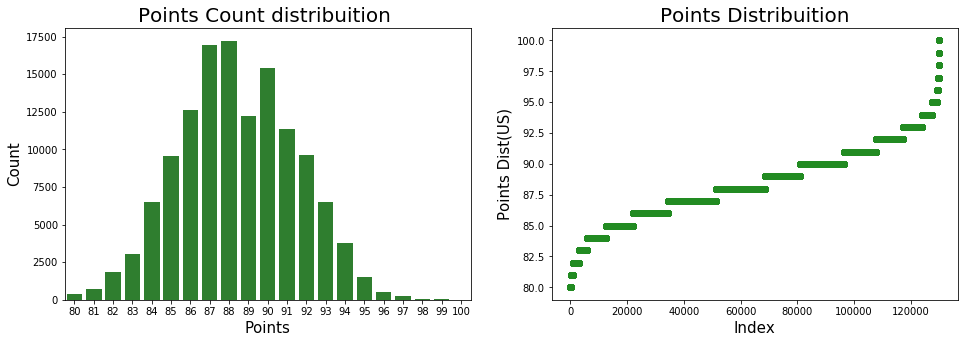

In [119]:
# define the size of figures that I will build
plt.figure(figsize=(16,5))

plt.subplot(1,2,1) # this will create a grid of 1 row and 2 columns; this is the first graphic
g = sns.countplot(x='points', data=df_wine1, color='forestgreen') # seting the seaborn countplot to known the points distribuition
g.set_title("Points Count distribuition ", fontsize=20) # seting title and size of font
g.set_xlabel("Points", fontsize=15) # seting xlabel and size of font
g.set_ylabel("Count", fontsize=15) # seting ylabel and size of font

plt.subplot(1,2,2)  # this will set the second graphic of our grid
plt.scatter(range(df_wine1.shape[0]), np.sort(df_wine1.points.values), color='forestgreen') # creating a cumulative distribution
plt.xlabel('Index', fontsize=15)  # seting xlabel and size of font
plt.ylabel('Points Dist(US)', fontsize=15)  # seting ylabel and size of font
plt.title("Points Distribuition", fontsize=20) # seting title and size of font

plt.show() #rendering the graphs

We can clearly see the distribuitioon of the data. It seems very similar with a normal distribution. 

Just a few number of wines have less than 82 points and more than 95 points. 

As Points are one of the most important metrics in this dataset, I will explore it furthuer more. 

I will find for more important informations like quantiles and maybe try to set wines in categories based on it

## Let's set the points into categories.
- I will create a new feature containing the range of the points with a rank to this pontuations

In [142]:
def cat_points(points):
    if points in list(range(80,83)):
        return 0
    elif points in list(range(83,87)):
        return 1
    elif points in list(range(87,90)):
        return 2
    elif points in list(range(90,94)):
        return 3
    elif points in list(range(94,98)):
        return 4
    else:
        return 5

df_wine1["rating_cat"] = df_wine1["points"].apply(cat_points)

## Ploting Rating categories
- Let's see the distribution after the transformation

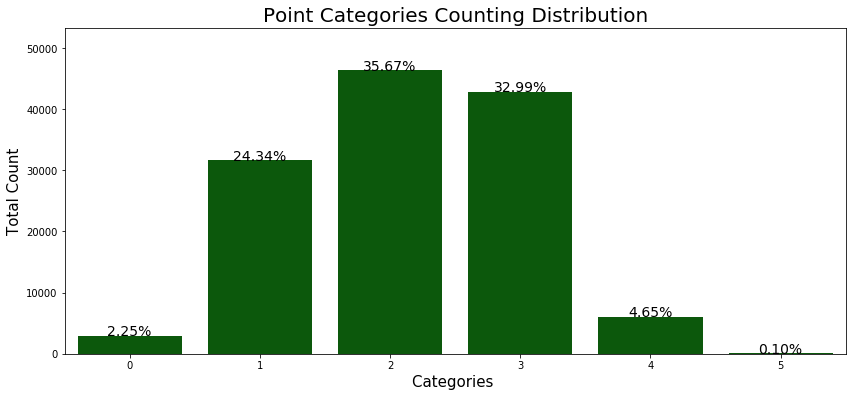

In [121]:
total = len(df_wine1)
plt.figure(figsize=(14,6))

g = sns.countplot(x='rating_cat', color='darkgreen',
                  data=df_wine1)
g.set_title("Point Categories Counting Distribution", fontsize=20)
g.set_xlabel("Categories ", fontsize=15)
g.set_ylabel("Total Count", fontsize=15)

sizes=[]

for p in g.patches:
    height = p.get_height()
    sizes.append(height)
    g.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.2f}%'.format((height/total)*100),
            ha="center", fontsize=14) 
    
g.set_ylim(0, max(sizes) * 1.15)

plt.show()

Nice! Now we can have a clearly understand of our data in a more clean way. It could be interesting to compare each other regions; 

to 

## Detecting Outlier Points

In [122]:
CalcOutliers(df_wine1['points'])

Identified lowest outliers: 0
Identified upper outliers: 129
Identified outliers: 129
Non-outlier observations: 129842
Total percentual of Outliers:  0.0994


Very interesting informations! 

We can see that all outliers of this feature is in upper values.<br>

Also, we have less than 0,01% of outlier values in points.... Just 129 wines have more than 98 points.  

We will apply it on Price too... Let's start the understanding of it now. 

# Price Distribution

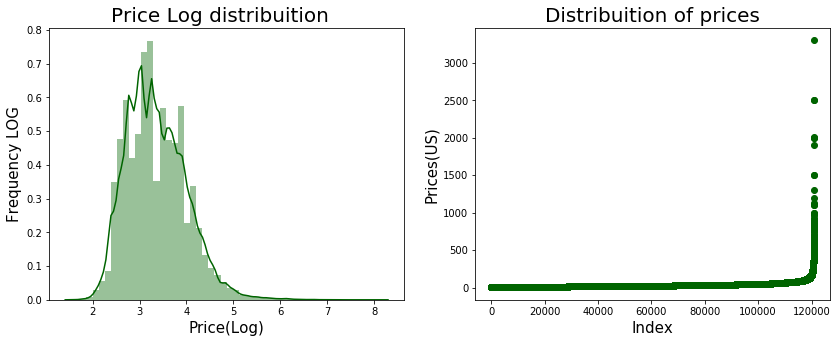

In [123]:
plt.figure(figsize=(14,5))

g1 = plt.subplot(121)
g1 = sns.distplot(np.log(df_wine1['price'].dropna() + 1),
                  color='darkgreen')
g1.set_title("Price Log distribuition  ", fontsize=20)
g1.set_xlabel("Price(Log)", fontsize=15)
g1.set_ylabel("Frequency LOG", fontsize=15)

plt.subplot(122)
plt.scatter(range(df_wine1.shape[0]), np.sort(df_wine1.price.values), 
            color='darkgreen')
plt.xlabel('Index', fontsize=15)
plt.ylabel('Prices(US)', fontsize=15)
plt.title("Distribuition of prices", fontsize=20)


plt.show()

Nice!!! The Price Log give us an impression that the data could normaly distributed, but like in points, we need to test.

## Outliers in Prices

In [124]:
CalcOutliers(df_wine1['price'])

Identified lowest outliers: 0
Identified upper outliers: 1177
Identified outliers: 1177
Non-outlier observations: 119798
Total percentual of Outliers:  0.9825


Cool. Now we can clearly see that we have less than 1% of outliers, that is 1177 prices that is out of our range

# Let's see a filtered distribution of Prices

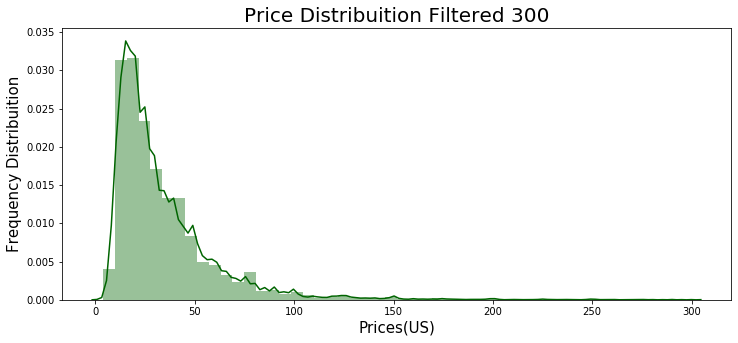

In [125]:
plt.figure(figsize=(12,5))

g = sns.distplot(df_wine1[df_wine1['price'] < 300]['price'], color='darkgreen')
g.set_title("Price Distribuition Filtered 300", fontsize=20)
g.set_xlabel("Prices(US)", fontsize=15)
g.set_ylabel("Frequency Distribuition", fontsize=15)


plt.show()

Nice. It confirms what we saw in the above exploration. The greastest part of all analyzed wines have values under $ 100;

In [126]:
# Let's get tehe price_log to better work with this feature
df_wine1['price_log'] = np.log(df_wine1['price'])

## Crossing prices and Points

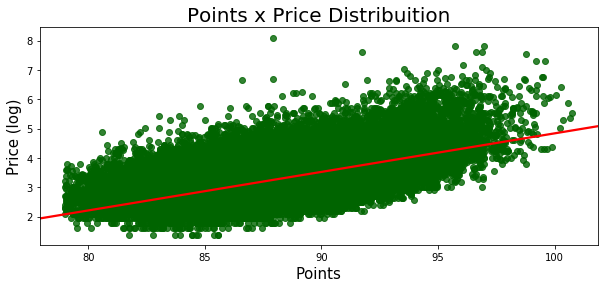

In [127]:
plt.figure(figsize=(10,4))

g = sns.regplot(x='points', y='price_log', 
                data=df_wine1, line_kws={'color':'red'},
                x_jitter=True, fit_reg=True, color='darkgreen')
g.set_title("Points x Price Distribuition", fontsize=20)
g.set_xlabel("Points", fontsize= 15)
g.set_ylabel("Price (log)", fontsize= 15)

plt.show()

Very meaningful scatter plot. 
- The highest prices isn't of the wine with highest pontuation. 
- The most expensive wine have ponctuation between 87 and 90

Maybe it would be interesting to build an recommender system to find cheapest wines with the same quality.

# Country Feature

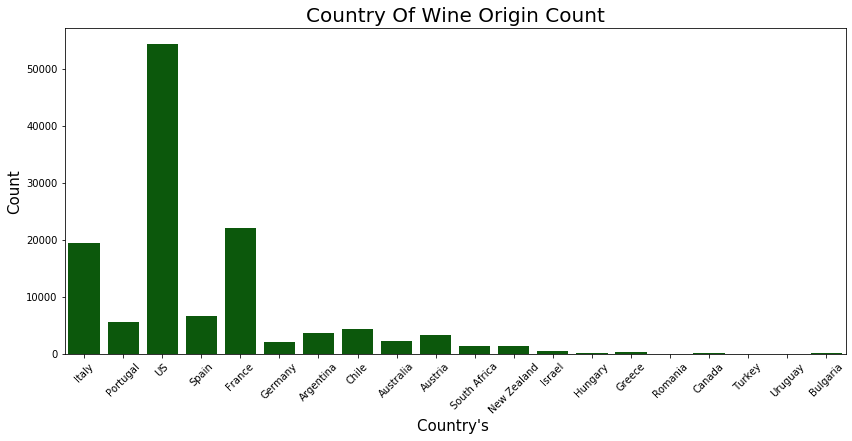

In [16]:
plt.figure(figsize=(14,6))

country = df_wine1.country.value_counts()[:20]

g = sns.countplot(x='country', 
                  data=df_wine1[df_wine1.country.isin(country.index.values)],
                 color='darkgreen')
g.set_title("Country Of Wine Origin Count", fontsize=20)
g.set_ylabel("Count", fontsize=15)
g.set_xticklabels(g.get_xticklabels(),rotation=45)

plt.show()

In [17]:
df_wine1.groupby(cat)['index'].count().reset_index().sort_values('index', ascending=False)[:15]

NameError: name 'cat' is not defined

In [18]:
def _distributions(cat_col, limit=15):
    tmp = df_wine1.groupby(cat_col)['index'].count().reset_index().sort_values('index', ascending=False)[:15]

    return px.bar(tmp, x=cat_col, y='index')

In [19]:
_distributions(cat_col='country')

KeyError: 'Column not found: index'

In [20]:
df_wine1.columns

Index(['country', 'description', 'designation', 'points', 'price', 'province',
       'region_1', 'region_2', 'taster_name', 'taster_twitter_handle', 'title',
       'variety', 'winery', 'rating_cat', 'price_log'],
      dtype='object')

In [21]:
resumetable(df_wine1[['country', 'province', 'region_1']])

Dataset Shape: (129971, 3)


,Name,dtypes,Missing,Uniques,First Value,Second Value,Third Value,Entropy
0,country,object,63,43,Italy,Portugal,US,2.77
1,province,object,63,425,Sicily & Sardinia,Douro,Oregon,5.05
2,region_1,object,21247,1229,Etna,NaN,Willamette Valley,7.89


In [22]:
px.histogram(df_wine1, x='price_log', nbins=80)

NameError: name 'px' is not defined

In [42]:
df_wine1.title.nunique() 

118840

ValueError: np.nan is an invalid document, expected byte or unicode string.

In [166]:
df_wine1.columns

Index(['country', 'description', 'designation', 'points', 'price', 'province',
       'region_1', 'region_2', 'taster_name', 'taster_twitter_handle', 'title',
       'variety', 'winery', 'harvest', 'description_desc', 'clusters',
       'Target_PCA0', 'Target_PCA1', 'Target_PCA2'],
      dtype='object')

0 : cherry, pinot, flavor, blackberry, dry, pinot noir, noir, currant, raspberry, wine
1 : cabernet, cabernet sauvignon, sauvignon, merlot, blend, franc, cabernet franc, verdot, petit verdot, petit
2 : wine, fruit, flavor, cherry, finish, spice, aroma, red, vineyard, tannin
3 : white, peach, flower, palate, aroma, citrus, apple, yellow, offer, white peach
4 : oak, new, french, french oak, flavor, fruit, vanilla, finish, aroma, wine
5 : lemon, lime, apple, palate, flavor, green, dry, grapefruit, finish, fresh
6 : black, aroma, cherry, palate, plum, berry, finish, flavor, tannin, black cherry
7 : flavor, finish, apple, peach, pear, fruit, chardonnay, melon, pineapple, citrus
8 : wine, fruit, tannin, wood, drink, ripe, rich, aging, acidity, firm
9 : wine, drink, ready, ready drink, fruity, acidity, fruit, crisp, ripe, attractive


117350

In [133]:
vec_text

<117350x2000 sparse matrix of type '<class 'numpy.float64'>'
	with 2937806 stored elements in Compressed Sparse Row format>

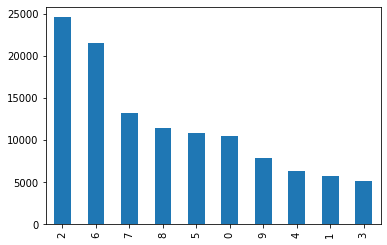

In [144]:
df_wine1['clusters'].value_counts().plot(kind='bar')

In [169]:
df_wine1.columns

Index(['country', 'description', 'designation', 'points', 'price', 'province',
       'region_1', 'region_2', 'taster_name', 'taster_twitter_handle', 'title',
       'variety', 'winery', 'rating_cat', 'price_log', 'harvest'],
      dtype='object')

In [152]:
df_wine1.year.value_counts()[:40].sort_index()

TypeError: '<' not supported between instances of 'int' and 'str'

In [131]:
first_cond = (t['country'] == 'Spain')
second_cond = (t['variety'] == 'Sherry')

t[first_cond & second_cond]

,country,province,variety,year,rating_cat,price,points,wineries,reviews
16428,Spain,Andalucia,Sherry,1827,4,14.0,94.0,1,1
16429,Spain,Andalucia,Sherry,1847,3,26.0,92.0,1,1
16430,Spain,Andalucia,Sherry,1986,3,155.0,92.0,1,2


In [ ]:
df_wine1[df_wine1]

In [101]:
df_wine1[(df_wine1['country'] == 'Argentina') & (df_wine1['province'] == 'Mendoza Province') & (df_wine1['variety'] == 'Bonarda') & (df_wine1['year'] == '2009')]['winery'].nunique()

10

In [102]:
df_wine1[(df_wine1['country'] == 'Argentina') & (df_wine1['province'] == 'Mendoza Province') & (df_wine1['variety'] == 'Bonarda') & (df_wine1['year'] == '2009')]['description'].nunique()

11

In [28]:
resumetable(df_wine1[['country', 'province', 'variety', 'points', 'price']])

Dataset Shape: (129971, 5)


,Name,dtypes,Missing,Uniques,First Value,Second Value,Third Value,Entropy
0,country,object,63,43,Italy,Portugal,US,2.77
1,province,object,63,425,Sicily & Sardinia,Douro,Oregon,5.05
2,variety,object,1,707,White Blend,Portuguese Red,Pinot Gris,5.67
3,points,int64,0,21,87,87,87,3.64
4,price,float64,8996,390,NaN,15,14,5.77


In [24]:
f = {'province':['nunique'], 'region_1':['nunique'], 'description':['nunique'], 'price':['min','mean','max']}


In [25]:
df_wine1

,country,description,designation,points,price,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery,rating_cat,price_log
0,Italy,"Aromas include tropical fruit, broom, brimston...",Vulkà Bianco,87,NaN,Sicily & Sardinia,Etna,NaN,Kerin O’Keefe,@kerinokeefe,Nicosia 2013 Vulkà Bianco (Etna),White Blend,Nicosia,2,NaN
1,Portugal,"This is ripe and fruity, a wine that is smooth...",Avidagos,87,15.0,Douro,NaN,NaN,Roger Voss,@vossroger,Quinta dos Avidagos 2011 Avidagos Red (Douro),Portuguese Red,Quinta dos Avidagos,2,2.708050
2,US,"Tart and snappy, the flavors of lime flesh and...",NaN,87,14.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,Rainstorm 2013 Pinot Gris (Willamette Valley),Pinot Gris,Rainstorm,2,2.639057
3,US,"Pineapple rind, lemon pith and orange blossom ...",Reserve Late Harvest,87,13.0,Michigan,Lake Michigan Shore,NaN,Alexander Peartree,NaN,St. Julian 2013 Reserve Late Harvest Riesling ...,Riesling,St. Julian,2,2.564949
4,US,"Much like the regular bottling from 2012, this...",Vintner's Reserve Wild Child Block,87,65.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,Sweet Cheeks 2012 Vintner's Reserve Wild Child...,Pinot Noir,Sweet Cheeks,2,4.174387
5,Spain,Blackberry and raspberry aromas show a typical...,Ars In Vitro,87,15.0,Northern Spain,Navarra,NaN,Michael Schachner,@wineschach,Tandem 2011 Ars In Vitro Tempranillo-Merlot (N...,Tempranillo-Merlot,Tandem,2,2.708050
6,Italy,"Here's a bright, informal red that opens with ...",Belsito,87,16.0,Sicily & Sardinia,Vittoria,NaN,Kerin O’Keefe,@kerinokeefe,Terre di Giurfo 2013 Belsito Frappato (Vittoria),Frappato,Terre di Giurfo,2,2.772589
7,France,This dry and restrained wine offers spice in p...,NaN,87,24.0,Alsace,Alsace,NaN,Roger Voss,@vossroger,Trimbach 2012 Gewurztraminer (Alsace),Gewürztraminer,Trimbach,2,3.178054
8,Germany,Savory dried thyme notes accent sunnier flavor...,Shine,87,12.0,Rheinhessen,NaN,NaN,Anna Lee C. Iijima,NaN,Heinz Eifel 2013 Shine Gewürztraminer (Rheinhe...,Gewürztraminer,Heinz Eifel,2,2.484907
9,France,This has great depth of flavor with its fresh ...,Les Natures,87,27.0,Alsace,Alsace,NaN,Roger Voss,@vossroger,Jean-Baptiste Adam 2012 Les Natures Pinot Gris...,Pinot Gris,Jean-Baptiste Adam,2,3.295837


In [26]:
f = {'price':['mean'], 'points':['mean'], 'winery':['nunique']}

t = df_wine1.groupby(['country', 'variety']).agg(f)
t.columns = t.columns.map('_'.join).to_series()

t.to_csv('data/matrix_wines.csv')

df_wine1.groupby(['country']).agg(f).reset_index()

country province region_1 description price             \
                            nunique  nunique     nunique   min       mean   
0                Argentina        2       31        3543   4.0  24.510117   
1                  Armenia        1        0           2  14.0  14.500000   
2                Australia        6       75        2197   5.0  35.437663   
3                  Austria       25        0        3033   7.0  30.762772   
4   Bosnia and Herzegovina        1        0           2  12.0  12.500000   
5                   Brazil        8        0          49  10.0  23.765957   
6                 Bulgaria        4        0         132   8.0  14.645390   
7                   Canada        3       12         226  12.0  35.712598   
8                    Chile       43        0        4184   5.0  20.786458   
9                    China        1        0           1  18.0  18.000000   
10                 Croatia       13        0          70  12.0  25.450704   
11                  Cyprus        6        0          10  11.0  16.272727   
12          Czech Republic        1        0          11  15.0  24.250000   
13                   Egypt        1        0           1   NaN        NaN   
14                 England        1        0          63  25.0  51.681159   
15                  France       11      386       20351   5.0  41.139120   
16                 Georgia        2        0          76   9.0  19.321429   
17                 Germany       13        0        1992   5.0  42.257547   
18                  Greece       54        0         431   8.0  22.364425   
19                 Hungary        8        0         129  10.0  40.648276   
20                   India        1        0           8  10.0  13.333333   
21                  Israel       14        0         466   8.0  31.768916   
22                   Italy       10      381       17921   5.0  39.663770   
23                 Lebanon        2        0          32  13.0  30.685714   
24              Luxembourg        1        0           5  16.0  23.333333   
25               Macedonia        1        0          11  15.0  15.583333   
26                  Mexico        3        0          68   8.0  26.785714   
27                 Moldova        3        0          56   8.0  16.745763   
28                 Morocco        3        0          24  14.0  19.500000   
29             New Zealand       19        0        1278   7.0  26.931785   
30                    Peru        1        0          16  10.0  18.062500   
31                Portugal       40        0        5256   5.0  26.218256   
32                 Romania       13        0         102   4.0  15.241667   
33                  Serbia        3        0           8  15.0  24.500000   
34                Slovakia        1        0           1  16.0  16.000000   
35                Slovenia        9        0          77   7.0  24.812500   
36            South Africa       42        0        1301   5.0  24.668987   
37                   Spain        8       81        6116   4.0  28.215275   
38             Switzerland        4        0           6  21.0  85.285714   
39                  Turkey        8        0          81  14.0  24.633333   
40                      US       27      264       50449   4.0  36.573464   
41                 Ukraine        1        0          14   6.0   9.214286   
42                 Uruguay        7        0          98  10.0  26.403670   

            
       max  
0    230.0  
1     15.0  
2    850.0  
3   1100.0  
4     13.0  
5     60.0  
6    100.0  
7    120.0  
8    400.0  
9     18.0  
10    65.0  
11    21.0  
12    45.0  
13     NaN  
14    95.0  
15  3300.0  
16    40.0  
17   775.0  
18    79.0  
19   764.0  
20    20.0  
21   150.0  
22   900.0  
23    75.0  
24    30.0  
25    20.0  
26   108.0  
27    42.0  
28    40.0  
29   130.0  
30    68.0  
31  1000.0  
32   320.0  
33    42.0  
34    16.0  
35    90.0  
36   330.0  
37   770.0  
38   160.0  
39   120.0  
40  201

In [27]:
metric_name_list=[col for col in df_wine1.columns if '_name' in col]
metric_level_list=[w.replace('_name', '') for w in metric_name_list]
dropdown_list=[{'label': key, 'value': value} for (key,value) in zip(metric_level_list,metric_name_list)]


In [ ]:
dropdown_list

In [34]:
df_wine1.groupby(['country', 'province'])['region_1'].nunique()

country    province        
Argentina  Mendoza Province    14
           Other               17
Armenia    Armenia              0
Australia  Australia Other      4
           New South Wales     10
                               ..
Uruguay    Juanico              0
           Montevideo           0
           Progreso             0
           San Jose             0
           Uruguay              0
Name: region_1, Length: 425, dtype: int64

In [83]:
#sunb_point = df_wine1.groupby(['country', 'province','region_1', 'variety', 'title']).agg(f).reset_index()
sunb_point = df_wine1.groupby(['country', 'province','region_1', 'variety'])['points'].mean().reset_index()
sunb_price = df_wine1.groupby(['country', 'province','region_1', 'variety'])['price'].mean().reset_index()
sunb_count = df_wine1.groupby(['country', 'province','region_1', 'variety'])['price'].count().reset_index()

sunb_point.to_csv("data/sunburst_point.csv")
sunb_price.to_csv("data/sunburst_price.csv")
sunb_count.to_csv("data/sunburst_count.csv")


In [97]:
f = {'price':['mean'], 'points':['mean'], 'description':['nunique'], 'title':['count']}

df_wine1.groupby(['country', 'province','region_1', 'variety']).agg(f).reset_index()['price']


,mean
0,17.857143
1,34.500000
2,40.800000
3,20.250000
4,15.000000
5,32.944444
6,39.000000
7,59.500000
8,35.000000
9,20.000000


In [38]:
import plotly_express as px

In [ ]:
var = ['Hungary']

In [132]:
''.join(var)

'Hungary'

In [129]:


df_wine1[df_wine1['country'] == var]

ValueError: Lengths must match to compare

In [69]:
f = {'price':['mean'], 'points':['mean'], 'title':['nunique']}

t = df_wine1.groupby(['country','winery','variety']).agg(f)
t.columns = t.columns.map('_'.join).to_series()

In [73]:
df_wine1[(df_wine1['country'] == 'Argentina') & (df_wine1['variety'] == 'Bonarda')]

,country,description,designation,points,price,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery,rating_cat,price_log,All
231,Argentina,"Meaty and rubbery, but that's young Bonarda. T...",NaN,85,10.0,Mendoza Province,Mendoza,NaN,Michael Schachner,@wineschach,Andean Sky 2007 Bonarda (Mendoza),Bonarda,Andean Sky,1,2.302585,Total
700,Argentina,"Intriguing aromas of lavender, hoja santa and ...",NaN,91,30.0,Mendoza Province,Mendoza,NaN,Michael Schachner,@wineschach,El Enemigo 2012 Bonarda (Mendoza),Bonarda,El Enemigo,3,3.401197,Total
734,Argentina,"Raisiny and earthy on the nose, this Bonarda a...",NaN,85,15.0,Mendoza Province,Mendoza,NaN,Michael Schachner,@wineschach,Durigutti 2014 Bonarda (Mendoza),Bonarda,Durigutti,1,2.708050,Total
1346,Argentina,"This is herbal and clipped smelling, with a sc...",NaN,86,11.0,Mendoza Province,Mendoza,NaN,Michael Schachner,@wineschach,Tilia 2011 Bonarda (Mendoza),Bonarda,Tilia,1,2.397895,Total
3573,Argentina,This Bonarda could be your everyday red or hou...,Single Vineyard,89,15.0,Mendoza Province,Agrelo,NaN,Michael Schachner,@wineschach,Lamadrid 2016 Single Vineyard Bonarda (Agrelo),Bonarda,Lamadrid,2,2.708050,Total
3961,Argentina,"Round, thick and pulsing, but not too hard, an...",Broquel,90,17.0,Mendoza Province,Mendoza,NaN,Michael Schachner,@wineschach,Trapiche 2008 Broquel Bonarda (Mendoza),Bonarda,Trapiche,3,2.833213,Total
4011,Argentina,"Bright, playful berry and plum aromas are clea...",NaN,88,14.0,Mendoza Province,Mendoza,NaN,Michael Schachner,@wineschach,Argento 2012 Bonarda (Mendoza),Bonarda,Argento,2,2.639057,Total
5304,Argentina,"Exotic on the nose, with aromas of raspberry, ...",NaN,88,12.0,Mendoza Province,Mendoza,NaN,Michael Schachner,@wineschach,Sur de los Andes 2010 Bonarda (Mendoza),Bonarda,Sur de los Andes,2,2.484907,Total
6504,Argentina,Earthy aromas of animal and stewed black fruit...,Made With Organic Grapes,82,15.0,Other,Argentina,NaN,Michael Schachner,@wineschach,Haarth 2013 Made With Organic Grapes Bonarda (...,Bonarda,Haarth,0,2.708050,Total
6508,Argentina,The intent here seems to be a low-alcohol “pur...,Pura,81,15.0,Mendoza Province,Mendoza,NaN,Michael Schachner,@wineschach,Via Revolucionaria 2015 Pura Bonarda (Mendoza),Bonarda,Via Revolucionaria,0,2.708050,Total


In [72]:
f = {'price':['mean'], 'points':['mean'], 'winery':['nunique']}

t = df_wine1.groupby(['country', 'variety']).agg(f)
t.columns = t.columns.map('_'.join).to_series()

t.to_csv('data/matrix_wines.csv')


price_mean  points_mean  winery_nunique
country   variety                                                            
Argentina Barbera                      18.000000    85.000000               1
          Bonarda                      16.628571    86.504762              42
          Bordeaux-style Red Blend     41.546512    89.820225              44
          Bordeaux-style White Blend   14.000000    83.000000               1
          Cabernet Blend               36.250000    88.250000               4
...                                          ...          ...             ...
Uruguay   Tannat-Cabernet Franc        19.000000    90.000000               2
          Tannat-Merlot                17.666667    86.500000               3
          Tannat-Syrah                 16.000000    84.000000               1
          Tempranillo-Tannat           20.000000    88.000000               1
          White Blend                  15.000000    87.000000               1

[1612 rows x 3 columns]

In [38]:
total df_wine1.groupby('All')['country'].unique().to_dict()

{'Total': array(['Italy', 'Portugal', 'US', 'Spain', 'France', 'Germany',
        'Argentina', 'Chile', 'Australia', 'Austria', 'South Africa',
        'New Zealand', 'Israel', 'Hungary', 'Greece', 'Romania', 'Mexico',
        'Canada', nan, 'Turkey', 'Czech Republic', 'Slovenia',
        'Luxembourg', 'Croatia', 'Georgia', 'Uruguay', 'England',
        'Lebanon', 'Serbia', 'Brazil', 'Moldova', 'Morocco', 'Peru',
        'India', 'Bulgaria', 'Cyprus', 'Armenia', 'Switzerland',
        'Bosnia and Herzegovina', 'Ukraine', 'Slovakia', 'Macedonia',
        'China', 'Egypt'], dtype=object)}

In [35]:
df_wine1['All'] = 'Total'

In [170]:
# d = {'sum':'foo','min':'bar','max':'bar2'}
# frame = df.groupby('A').agg({'B' : ['sum'], 'C': ['min', 'max']}).rename(columns=d)

f = {'price':['mean'], 'points':['mean'], 'taster_name':['nunique'], 'description':['nunique'], 'title':['count']}

agg_1 = df_wine1.groupby(['country', 'province', 'region_1', 'variety']).agg(f).reset_index()
agg_1.columns = agg_1.columns.map('_'.join).to_series()


In [56]:

df_wine1[df_wine1['country'].isin(df_wine1.groupby('country')['province'].unique()['Argentina'])]

,country,description,designation,points,price,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery,rating_cat,price_log,All


In [60]:
df_wine1.groupby('country')['province'].unique().to_dict()['Argentina']

array(['Other', 'Mendoza Province'], dtype=object)

In [34]:
df_wine1.sample(500).to_dict('records')

[{'country': 'France',
  'description': 'This is a round, ripe and deliciously smooth wine. With a warm, vanilla character as well as full and rich fruit, it is generous and ready to drink. The acidity at the end leaves a refreshing aftertaste.',
  'designation': 'Les Chasseignes',
  'points': 88,
  'price': 30.0,
  'province': 'Loire Valley',
  'region_1': 'Sancerre',
  'region_2': nan,
  'taster_name': 'Roger Voss',
  'taster_twitter_handle': '@vossroger',
  'title': 'Domaine Fouassier 2015 Les Chasseignes  (Sancerre)',
  'variety': 'Sauvignon Blanc',
  'winery': 'Domaine Fouassier',
  'rating_cat': 2,
  'price_log': 3.4011973816621555},
 {'country': 'US',
  'description': 'This is an outstanding Protagonist, 75% Cabernet Sauvignon and 25% Ciel du Cheval Syrah. As with other J. Bookwalter reds, it is loaded with an appealing toast scent, and is amply endowed with black cherry and cassis fruit. This is a luscious wine with terrific concentration and length, finishing with perfectly ri

In [24]:


df_wine1[(df_wine1['country'] == 'US') & (None)]['winery']



TypeError: cannot compare a dtyped [bool] array with a scalar of type [NoneType]

In [82]:
%%time

df_wine1[df_wine1['country'] == 'Italy'].head(1)

CPU times: user 16.5 ms, sys: 341 µs, total: 16.8 ms
Wall time: 16 ms


,country,description,designation,points,price,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery,rating_cat,price_log,All
0,Italy,"Aromas include tropical fruit, broom, brimston...",Vulkà Bianco,87,NaN,Sicily & Sardinia,Etna,NaN,Kerin O’Keefe,@kerinokeefe,Nicosia 2013 Vulkà Bianco (Etna),White Blend,Nicosia,2,NaN,Total


CPU times: user 32.9 ms, sys: 617 µs, total: 33.5 ms
Wall time: 32 ms


,country,description,designation,points,price,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery,rating_cat,price_log,All
0,Italy,"Aromas include tropical fruit, broom, brimston...",Vulkà Bianco,87,NaN,Sicily & Sardinia,Etna,NaN,Kerin O’Keefe,@kerinokeefe,Nicosia 2013 Vulkà Bianco (Etna),White Blend,Nicosia,2,NaN,Total


In [157]:
print(f"Unique Titles {df_wine1[df_wine1['country'] == 'US']['title'].nunique()}")
print(f"Total Wineries in the country {df_wine1[df_wine1['country'] == 'US']['winery'].nunique()}")   
print(f"Total Tasters in the country {df_wine1[df_wine1['country'] == 'US']['taster_name'].nunique()}")
print(f"Total Varieties: {df_wine1[df_wine1['country'] == 'US']['variety'].nunique()}")

df_wine1[(df_wine1['country'] == 'US') & (df_wine1['variety'] == 'Pinot Noir')]['winery']

Unique Titles 50229
Total Wineries in the country 5375
Total Tasters in the country 15
Total Varieties: 257


4                Sweet Cheeks
21                    Acrobat
25        Castello di Amorosa
35                      Erath
41            Hawkins Cellars
                 ...         
129872               Brutocao
129888            August West
129912                Dunstan
129920                   Pali
129967               Citation
Name: winery, Length: 9885, dtype: object

In [134]:
agg_1.columns = agg_1.columns.map('_'.join).to_series()

,country,description,designation,points,price,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery,rating_cat,price_log
2,US,"Tart and snappy, the flavors of lime flesh and...",NaN,87,14.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,Rainstorm 2013 Pinot Gris (Willamette Valley),Pinot Gris,Rainstorm,2,2.639057
3,US,"Pineapple rind, lemon pith and orange blossom ...",Reserve Late Harvest,87,13.0,Michigan,Lake Michigan Shore,NaN,Alexander Peartree,NaN,St. Julian 2013 Reserve Late Harvest Riesling ...,Riesling,St. Julian,2,2.564949
4,US,"Much like the regular bottling from 2012, this...",Vintner's Reserve Wild Child Block,87,65.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,Sweet Cheeks 2012 Vintner's Reserve Wild Child...,Pinot Noir,Sweet Cheeks,2,4.174387
10,US,"Soft, supple plum envelopes an oaky structure ...",Mountain Cuvée,87,19.0,California,Napa Valley,Napa,Virginie Boone,@vboone,Kirkland Signature 2011 Mountain Cuvée Caberne...,Cabernet Sauvignon,Kirkland Signature,2,2.944439
12,US,"Slightly reduced, this wine offers a chalky, t...",NaN,87,34.0,California,Alexander Valley,Sonoma,Virginie Boone,@vboone,Louis M. Martini 2012 Cabernet Sauvignon (Alex...,Cabernet Sauvignon,Louis M. Martini,2,3.526361
14,US,Building on 150 years and six generations of w...,NaN,87,12.0,California,Central Coast,Central Coast,Matt Kettmann,@mattkettmann,Mirassou 2012 Chardonnay (Central Coast),Chardonnay,Mirassou,2,2.484907
19,US,"Red fruit aromas pervade on the nose, with cig...",NaN,87,32.0,Virginia,Virginia,NaN,Alexander Peartree,NaN,Quiévremont 2012 Meritage (Virginia),Meritage,Quiévremont,2,3.465736
20,US,Ripe aromas of dark berries mingle with ample ...,Vin de Maison,87,23.0,Virginia,Virginia,NaN,Alexander Peartree,NaN,Quiévremont 2012 Vin de Maison Red (Virginia),Red Blend,Quiévremont,2,3.135494
21,US,"A sleek mix of tart berry, stem and herb, alon...",NaN,87,20.0,Oregon,Oregon,Oregon Other,Paul Gregutt,@paulgwine,Acrobat 2013 Pinot Noir (Oregon),Pinot Noir,Acrobat,2,2.995732
23,US,This wine from the Geneseo district offers aro...,Signature Selection,87,22.0,California,Paso Robles,Central Coast,Matt Kettmann,@mattkettmann,Bianchi 2011 Signature Selection Merlot (Paso ...,Merlot,Bianchi,2,3.091042


In [ ]:
def _bar_update(data, color='rating_cat' )
    fig = px.scatter(test, x='price_log', y='points',
                     color=color, hover_name='variety',
                     hover_data=['country', 'price'], 
                     height=450, width=450)

    fig.update_layout(showlegend=False)
    
    return fig


In [128]:

test = round(df_wine1.groupby(['country', 'rating_cat', 'variety'])['price_log', 'price','points'].mean().reset_index(),2)
test.to_csv('data/matrix_wines.csv')

def _scatter(data, color='rating_cat' )
    fig = px.scatter(test, x='price_log', y='points',
                     color=color, hover_name='variety',
                     hover_data=['country', 'price'], 
                     height=450, width=450)

    fig.update_layout(showlegend=False)
    
    return fig

_scatter(test)

In [85]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import pandas as pd

df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/sales_success.csv')
print(df.head())

levels = ['salesperson', 'county', 'region'] # levels used for the hierarchical chart
color_columns = ['sales', 'calls']
value_column = 'price'

def build_hierarchical_dataframe(df, levels, value_column, color_columns=None):
    """
    Build a hierarchy of levels for Sunburst or Treemap charts.

    Levels are given starting from the bottom to the top of the hierarchy,
    ie the last level corresponds to the root.
    """
    df_all_trees = pd.DataFrame(columns=['id', 'parent', 'value', 'color'])
    for i, level in enumerate(levels):
        df_tree = pd.DataFrame(columns=['id', 'parent', 'value', 'color'])
        dfg = df.groupby(levels[i:]).sum(numerical_only=True)
        dfg = dfg.reset_index()
        df_tree['id'] = dfg[level].copy()
        if i < len(levels) - 1:
            df_tree['parent'] = dfg[levels[i+1]].copy()
        else:
            df_tree['parent'] = 'total'
        df_tree['value'] = dfg[value_column]
        df_tree['color'] = dfg[color_columns[0]] / dfg[color_columns[1]]
        df_all_trees = df_all_trees.append(df_tree, ignore_index=True)
    total = pd.Series(dict(id='total', parent='',
                              value=df[value_column].sum(),
                              color=df[color_columns[0]].sum() / df[color_columns[1]].sum()))
    df_all_trees = df_all_trees.append(total, ignore_index=True)
    return df_all_trees


df_all_trees = build_hierarchical_dataframe(df, levels, value_column, color_columns)
average_score = df['sales'].sum() / df['calls'].sum()

fig = make_subplots(1, 2, specs=[[{"type": "domain"}, {"type": "domain"}]],)

fig.add_trace(go.Sunburst(
    labels=df_all_trees['id'],
    parents=df_all_trees['parent'],
    values=df_all_trees['value'],
    branchvalues='total',
    marker=dict(
        colors=df_all_trees['color'],
        colorscale='RdBu',
        cmid=average_score),
    hovertemplate='<b>%{label} </b> <br> Sales: %{value}<br> Success rate: %{color:.2f}',
    name=''
    ), 1, 1)

fig.add_trace(go.Sunburst(
    labels=df_all_trees['id'],
    parents=df_all_trees['parent'],
    values=df_all_trees['value'],
    branchvalues='total',
    marker=dict(
        colors=df_all_trees['color'],
        colorscale='RdBu',
        cmid=average_score),
    hovertemplate='<b>%{label} </b> <br> Sales: %{value}<br> Success rate: %{color:.2f}',
    maxdepth=2
    ), 1, 2)

fig.update_layout(margin=dict(t=10, b=10, r=10, l=10))
fig.show()

   Unnamed: 0 region   county salesperson  calls  sales
0           0  North   Dallam          JE     35     23
1           1  North   Dallam          ZQ     49     13
2           2  North   Dallam          IJ     20      6
3           3  North  Hartley          WE     39     37
4           4  North  Hartley          PL     42     37


In [148]:
def build_hierarchical_dataframe(df, levels, value_column, color_columns=None):
    """
    Build a hierarchy of levels for Sunburst or Treemap charts.

    Levels are given starting from the bottom to the top of the hierarchy,
    ie the last level corresponds to the root.
    """
    df_all_trees = pd.DataFrame(columns=['id', 'parent', 'value', 'color'])
    for i, level in enumerate(levels):
        df_tree = pd.DataFrame(columns=['id', 'parent', 'value', 'color'])
        dfg = df.groupby(levels[i:]).sum(numerical_only=True)
        dfg = dfg.reset_index()
        df_tree['id'] = dfg[level].copy()
        if i < len(levels) - 1:
            df_tree['parent'] = dfg[levels[i+1]].copy()
        else:
            df_tree['parent'] = 'total'
        df_tree['value'] = dfg[value_column]
        df_tree['color'] = dfg[color_columns[0]] / dfg[color_columns[1]]
        df_all_trees = df_all_trees.append(df_tree, ignore_index=True)
    total = pd.Series(dict(id='total', parent='',
                              value=df[value_column].sum(),
                              color=df[color_columns[0]].sum() / df[color_columns[1]].sum()))
    df_all_trees = df_all_trees.append(total, ignore_index=True)
    return df_all_trees

levels = ['country', 'province','region_1', 'variety']
color_columns = ['price']
value_column = ['price']

df_all_trees = build_hierarchical_dataframe(sunb_count, levels, value_column, color_columns) 

IndexError: list index out of range

In [89]:
df_all_trees['parent']


0      Houston
1      Hartley
2     Brewster
3     Presidio
4        Duval
        ...   
68       total
69       total
70       total
71       total
72            
Name: parent, Length: 73, dtype: object

In [ ]:
sunb['region_1'].value_counts()

In [154]:
fig = px.sunburst(sunb_count, path=['country', 'province', 'region_1','variety'], 
                  values='price', height=700, maxdepth=2, branchvalues='total')

In [155]:
fig

In [82]:
fig.data

(Sunburst({
     'branchvalues': 'total',
     'domain': {'x': [0.0, 1.0], 'y': [0.0, 1.0]},
     'hoverlabel': {'namelength': 0},
     'hovertemplate': 'labels=%{label}<br>points=%{value}<br>parent=%{parent}<br>id=%{id}',
     'ids': array(['Spain/Catalonia/Penedès/Cabernet Sauvignon/1+1=3 2008 Rosé Cabernet Sauvignon (Penedès)',
                   'Spain/Catalonia/Cava/Sparkling Blend/1+1=3 NV Brut Sparkling (Cava)',
                   'Spain/Catalonia/Cava/Sparkling Blend/1+1=3 NV Cygnus Brut Nature Reserva Made With Organic Grapes Sparkling (Cava)',
                   ..., 'Italy', 'Spain', 'US'], dtype=object),
     'labels': array(['1+1=3 2008 Rosé Cabernet Sauvignon (Penedès)',
                      '1+1=3 NV Brut Sparkling (Cava)',
                      '1+1=3 NV Cygnus Brut Nature Reserva Made With Organic Grapes Sparkling (Cava)',
                      ..., 'Italy', 'Spain', 'US'], dtype=object),
     'maxdepth': 2,
     'name': '',
     'parents': array(['Spain/Catalonia/Pen

In [ ]:
[province for province in df_wine1[df_wine1['country'] == country]['province']:
             country for country in df_wine1['country']]



In [ ]:
import itertools
for combination in itertools.product(*df_wine1[['country', 'province', 'region_1']]):
    print( combination)

In [ ]:
 'country', 'province', 'region_1', 'taster_name', 'title', 'variety', 'winery'

In [ ]:
tmp = df_wine1.groupby('country')['index'].count().reset_index().sort_values('index', ascending=False)[:15]

px.bar(tmp, x='country', y='index')

Wow, very interesting distribuition. I was expecting to see Italy, Chile or Argentina as the biggest wine productor. <br>
 If you want take a better look, look the print output below

## Now, I will take a look in the distribuition of this top 20 countrys by price and rating

In [ ]:
plt.figure(figsize=(16,12))

plt.subplot(2,1,1)
g = sns.boxplot(x='country', y='price_log',
                  data=df_wine1.loc[(df_wine1.country.isin(country.index.values))],
                 color='darkgreen')
g.set_title("Price by Country Of Wine Origin", fontsize=20)
g.set_xlabel("Country's ", fontsize=15)
g.set_ylabel("Price Dist(US)", fontsize=15)
g.set_xticklabels(g.get_xticklabels(),rotation=45)

plt.subplot(2,1,2)
g1 = sns.boxplot(x='country', y='points',
                   data=df_wine1[df_wine1.country.isin(country.index.values)],
                 color='darkgreen')
g1.set_title("Points by Country Of Wine Origin", fontsize=20)
g1.set_xlabel("Country's ", fontsize=15)
g1.set_ylabel("Points", fontsize=15)
g1.set_xticklabels(g1.get_xticklabels(),rotation=45)

plt.subplots_adjust(hspace = 0.6,top = 0.9)

plt.show()

## Taking a look on values lowest than 500

In [ ]:
plt.figure(figsize=(15,5))
g = sns.boxplot(x='country', y='price_log', color='darkgreen',
                  data=df_wine1)
g.set_title("Price by Country Of Wine Origin", fontsize=20)
g.set_xlabel("Country's ", fontsize=15)
g.set_ylabel("Price Dist(US)", fontsize=15)
g.set_xticklabels(g.get_xticklabels(),rotation=90)

plt.show()

It's very interesting that all wines have  quartiles in a values lower than 100

## Province Exploration

In [ ]:
plt.figure(figsize=(14,15))

provinces = df_wine1['province'].value_counts()[:20]

plt.subplot(3,1,1)
g = sns.countplot(x='province', 
                  data=df_wine1.loc[(df_wine1.province.isin(provinces.index.values))], 
                  color='darkgreen')
g.set_title("Province Of Wine Origin ", fontsize=20)
g.set_xlabel("Provinces", fontsize=15)
g.set_ylabel("Count", fontsize=15)
g.set_xticklabels(g.get_xticklabels(),rotation=45)

plt.subplot(3,1,2)
g1 = sns.boxplot(y='price', x='province',
                  data=df_wine1.loc[(df_wine1.province.isin(provinces.index.values))], 
                  color='darkgreen')
g1.set_title("Province Of Wine Origin ", fontsize=20)
g1.set_xlabel("Province", fontsize=15)
g1.set_ylabel("Price", fontsize=15)
g1.set_xticklabels(g1.get_xticklabels(),rotation=45)

plt.subplot(3,1,3)
g2 = sns.boxplot(y='points', x='province',
                  data=df_wine1.loc[(df_wine1.province.isin(provinces.index.values))], 
                  color='darkgreen')
g2.set_title("Province Of Wine Origin", fontsize=20)
g2.set_xlabel("Provinces", fontsize=15)
g2.set_ylabel("Points", fontsize=15)
g2.set_xticklabels(g2.get_xticklabels(),rotation=45)

plt.subplots_adjust(hspace = 0.6,top = 0.9)

plt.show()

# Taster Feature

In [ ]:
plt.figure(figsize=(14,16))

provinces = df_wine1['province'].value_counts()[:20]

plt.subplot(3,1,1)
g = sns.countplot(x='taster_name', data=df_wine1, color='darkgreen')
g.set_title("Taster Name Count - TOP 20 ", fontsize=20)
g.set_xlabel("Taster Name", fontsize=15)
g.set_ylabel("Count", fontsize=15)
g.set_xticklabels(g.get_xticklabels(),rotation=45)

plt.subplot(3,1,2)
g1 = sns.boxplot(y='price_log', x='taster_name', data=df_wine1, 
                 color='darkgreen')
g1.set_title("Taster Name Wine Values Distribuition ", fontsize=20)
g1.set_xlabel("Taster Name", fontsize=15)
g1.set_ylabel("Price", fontsize=15)
g1.set_xticklabels(g1.get_xticklabels(),rotation=45)

plt.subplot(3,1,3)
g2 = sns.boxplot(y='points', x='taster_name',
                  data=df_wine1, color='darkgreen')
g2.set_title("Taster Name Points Distribuition", fontsize=20)
g2.set_xlabel("Taster Name", fontsize=15)
g2.set_ylabel("Points", fontsize=15)
g2.set_xticklabels(g2.get_xticklabels(),rotation=45)

plt.subplots_adjust(hspace = 0.6,top = 0.9)

plt.show()

## PROVINVCE FEATURE

In [ ]:
plt.figure(figsize=(14,16))

designation = df_wine1.designation.value_counts()[:20]

plt.subplot(3,1,1)
g = sns.countplot(x='designation', 
                  data=df_wine1.loc[(df_wine1.designation.isin(designation.index.values))],
                  color='darkgreen')
g.set_title("Province Of Wine Origin ", fontsize=20)
g.set_xlabel("Country's ", fontsize=15)
g.set_ylabel("Count", fontsize=15)
g.set_xticklabels(g.get_xticklabels(),rotation=45)

plt.subplot(3,1,2)
g1 = sns.boxplot(y='price_log', x='designation',
                  data=df_wine1.loc[(df_wine1.designation.isin(designation.index.values))], 
                 color='darkgreen')
g1.set_title("Province Of Wine Origin ", fontsize=20)
g1.set_xlabel("Province", fontsize=15)
g1.set_ylabel("Price", fontsize=15)
g1.set_xticklabels(g1.get_xticklabels(),rotation=45)

plt.subplot(3,1,3)
g2 = sns.boxplot(y='points', x='designation',
                  data=df_wine1.loc[(df_wine1.designation.isin(designation.index.values))], 
                 color='darkgreen')
g2.set_title("Province Of Wine Origin", fontsize=20)
g2.set_xlabel("Provinces", fontsize=15)
g2.set_ylabel("Points", fontsize=15)
g2.set_xticklabels(g2.get_xticklabels(),rotation=45)

plt.subplots_adjust(hspace = 0.6,top = 0.9)

plt.show()

## VARIETY FEATURE

In [ ]:
plt.figure(figsize=(14,16))

variety = df_wine1.variety.value_counts()[:20]

plt.subplot(3,1,1)
g = sns.countplot(x='variety', 
                  data=df_wine1.loc[(df_wine1.variety.isin(variety.index.values))], 
                  color='darkgreen')
g.set_title("TOP 20 Variety ", fontsize=20)
g.set_xlabel(" ", fontsize=15)
g.set_ylabel("Count", fontsize=15)
g.set_xticklabels(g.get_xticklabels(),rotation=45)

plt.subplot(3,1,2)
g1 = sns.boxplot(y='price_log', x='variety',
                  data=df_wine1.loc[(df_wine1.variety.isin(variety.index.values))], 
                 color='darkgreen')
g1.set_title("Price by Variety's", fontsize=20)
g1.set_xlabel("", fontsize=15)
g1.set_ylabel("Price", fontsize=15)
g1.set_xticklabels(g1.get_xticklabels(),rotation=45)

plt.subplot(3,1,3)
g2 = sns.boxplot(y='points', x='variety',
                  data=df_wine1.loc[(df_wine1.variety.isin(variety.index.values))], 
                 color='darkgreen')
g2.set_title("Points by Variety's", fontsize=20)
g2.set_xlabel("Variety's", fontsize=15)
g2.set_ylabel("Points", fontsize=15)
g2.set_xticklabels(g2.get_xticklabels(),rotation=90)

plt.subplots_adjust(hspace = 0.7,top = 0.9)

plt.show()

## Let's take a look at Winery Distribuitions 

# Generate a word cloud image
mask = np.array(Image.open("img/france.png"))
wordcloud_fra = WordCloud(stopwords=stopwords, background_color="white",
                          mode="RGBA", max_words=5200, mask=mask).generate(fra)

# create coloring from image
image_colors = ImageColorGenerator(mask)
plt.figure(figsize=[7,7])
plt.imshow(wordcloud_fra.recolor(color_func=image_colors), interpolation="bilinear")
plt.axis("off")

# store to file
plt.savefig("img/fra_wine.png", format="png")

#plt.show()

In [ ]:
plt.figure(figsize=(14,16))

winery = df_wine1.winery.value_counts()[:20]

plt.subplot(3,1,1)
g = sns.countplot(x='winery', 
                  data=df_wine1.loc[(df_wine1.winery.isin(winery.index.values))], 
                  color='darkgreen')
g.set_title("TOP 20 most frequent Winery's", fontsize=20)
g.set_xlabel(" ", fontsize=15)
g.set_ylabel("Count", fontsize=15)
g.set_xticklabels(g.get_xticklabels(),rotation=45)

plt.subplot(3,1,2)
g1 = sns.boxplot(y='price_log', x='winery',
                  data=df_wine1.loc[(df_wine1.winery.isin(winery.index.values))],
                 color='darkgreen')
g1.set_title("Price by Winery's", fontsize=20)
g1.set_xlabel("", fontsize=15)
g1.set_ylabel("Price", fontsize=15)
g1.set_xticklabels(g1.get_xticklabels(),rotation=45)

plt.subplot(3,1,3)
g2 = sns.boxplot(y='points', x='winery',
                  data=df_wine1.loc[(df_wine1.winery.isin(winery.index.values))],
                 color='darkgreen')
g2.set_title("Points by Winery's", fontsize=20)
g2.set_xlabel("Winery's", fontsize=15)
g2.set_ylabel("Points", fontsize=15)
g2.set_xticklabels(g2.get_xticklabels(),rotation=90)

plt.subplots_adjust(hspace = 0.7,top = 0.9)

plt.show()

We can see that some winery's have +- 200 label in his portfolio's. 

Also, we can verify that Willians Selyem have highest points distribuition

Better understanding the lenght of reviews

In [ ]:
df_wine1 = df_wine1.assign(desc_length = df_wine1['description'].apply(len))

plt.figure(figsize=(14,6))
g = sns.boxplot(x='points', y='desc_length', data=df_wine1,
                color='darkgreen')
g.set_title('Description Length by Points', fontsize=20)
g.set_ylabel('Description Length', fontsize = 16) # Y label
g.set_xlabel('Points', fontsize = 16) # X label
plt.show()

Very cool! We can see that the wine's with highest points also have the biggest descriptions length. It's very interesting to understand.


## Who are the sommeliers with biggest descriptions length?!

In [ ]:
plt.figure(figsize=(14,6))

g = sns.boxplot(x='taster_name', y='desc_length', 
                data=df_wine1, color='darkgreen')
g.set_title('Description Length by Taster Name', fontsize=20)
g.set_ylabel('Description Length', fontsize = 16) # Y label
g.set_xlabel('Taster Name', fontsize = 16) # X label
g.set_xticklabels(g.get_xticklabels(),rotation=45)
plt.show()

Wow, we can see a difference description length per taster name

## Scatter plot of the description length and the price

In [ ]:
plt.figure(figsize=(14,6))

g = sns.regplot(x='desc_length', y='price_log', line_kws={'color':'red'},
                data=df_wine1, fit_reg=True, color='darkgreen', )
g.set_title('Price by Description Length', fontsize=20)
g.set_ylabel('Price(USD)', fontsize = 16) 
g.set_xlabel('Description Length', fontsize = 16)
g.set_xticklabels(g.get_xticklabels(),rotation=45)

plt.show()

## WORDCLOUDS OF DESCRIPTIONS

In [ ]:

from wordcloud import WordCloud, STOPWORDS

stopwords = set(STOPWORDS)

newStopWords = ['fruit', "Drink", "black", 'wine', 'drink']

stopwords.update(newStopWords)

wordcloud = WordCloud(
    background_color='white',
    stopwords=stopwords,
    max_words=300,
    max_font_size=200, 
    width=1000, height=800,
    random_state=42,
).generate(" ".join(df_wine1['description'].astype(str)))

print(wordcloud)
fig = plt.figure(figsize = (12,14))
plt.imshow(wordcloud)
plt.title("WORD CLOUD - DESCRIPTION",fontsize=25)
plt.axis('off')
plt.show()

In [ ]:
df_wine1 = df_wine1.reset_index()

In [ ]:
df_wine1.country.value_counts()[:20].index

In [ ]:
px.histogram(df_wine1, x='country', histnorm='count')

## WORDCLOUD OF WINE TITLES

In [ ]:
wordcloud = WordCloud(
    background_color='white',
    stopwords=stopwords,
    max_words=300,
    max_font_size=200, 
    width=1000, height=800,
    random_state=42,
).generate(" ".join(df_wine1['title'].astype(str)))

print(wordcloud)
fig = plt.figure(figsize = (12,14))
plt.imshow(wordcloud)
plt.title("WORD CLOUD - TITLES",fontsize=25)
plt.axis('off')
plt.show()

# TFIDF Vectorizer in the Wine Review

## Description N-gram 

In [ ]:
country.index[:1].values

In [20]:
df_wine1.loc[(df_wine1.country == 'Portugal') & (df_wine1.variety == 'Ramisco')][['country', 'variety', 'title', 'points', 'price']]

,country,variety,title,points,price
107854,Portugal,Ramisco,Adega Viuva Gomes 1934 Reserva Velho Red (Cola...,93,495.0


In [21]:
resumetable(df_wine1)

Dataset Shape: (129971, 15)


,Name,dtypes,Missing,Uniques,First Value,Second Value,Third Value,Entropy
0,country,object,63,43,Italy,Portugal,US,2.77
1,description,object,0,119955,"Aromas include tropical fruit, broom, brimston...","This is ripe and fruity, a wine that is smooth...","Tart and snappy, the flavors of lime flesh and...",16.83
2,designation,object,37465,37979,Vulkà Bianco,Avidagos,NaN,13.83
3,points,int64,0,21,87,87,87,3.64
4,price,float64,8996,390,NaN,15,14,5.77
5,province,object,63,425,Sicily & Sardinia,Douro,Oregon,5.05
6,region_1,object,21247,1229,Etna,NaN,Willamette Valley,7.89
7,region_2,object,79460,17,NaN,NaN,Willamette Valley,3.28
8,taster_name,object,26244,19,Kerin O’Keefe,Roger Voss,Paul Gregutt,3.39
9,taster_twitter_handle,object,31213,15,@kerinokeefe,@vossroger,@paulgwine,3.23


In [23]:
df_wine1.groupby(['country','province','variety'])['price', 'points'].mean()

price     points
country   province         variety                                         
Argentina Mendoza Province Bonarda                     16.717172  86.606061
                           Bordeaux-style Red Blend    41.585366  89.905882
                           Bordeaux-style White Blend  14.000000  83.000000
                           Cabernet Blend              36.250000  88.250000
                           Cabernet Franc              48.228070  89.614035
...                                                          ...        ...
Uruguay   Uruguay          Pinot Noir                  30.000000  90.000000
                           Red Blend                   24.000000  87.750000
                           Sauvignon Blanc             16.000000  84.000000
                           Tannat                      23.727273  87.272727
                           Tannat-Cabernet Franc       22.000000  91.000000

[4119 rows x 2 columns]

In [ ]:
df_wine1.columns

In [ ]:
agg = {['price','points']:}

In [ ]:
matrix = df_wine1.groupby(['country', 'province', 'region_1', #'winery',
                  'variety'])['price','points'].mean().reset_index()

In [ ]:
matrix

px.bar(matrix[(matrix['country'] == "US") & 
       (matrix['region_1'] == "Yountville")], x='variety', y='price')

In [ ]:
matrix[(matrix['country'] == "US") & 
       (matrix['region_1'] == "Yountville")]

In [ ]:
df_wine1.loc[(df_wine1.country == 'US')]['description']

In [ ]:

vectorizer = TfidfVectorizer(ngram_range = (2, 3), min_df=3, 
                             stop_words='english', max_features=20,
                             max_df=.4)

X2 = vectorizer.fit_transform(df_wine1.loc[(df_wine1.country == 'US')]['description']) 
features = (vectorizer.get_feature_names()) 
scores = (X2.toarray()) 

# Getting top ranking features 
sums = X2.sum(axis = 0) 
data1 = [] 

for col, term in enumerate(features): 
    data1.append( (term, sums[0,col] )) 

ranking = pd.DataFrame(data1, columns = ['term','rank']) 
words = (ranking.sort_values('rank', ascending = False))[:15]

fig = px.bar(words, x='term', y='rank', #ax=ax, 
            #color='blue', #orient='v'
      )

print(fig)

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
import matplotlib.gridspec as gridspec # to do the grid of plots

# grid = gridspec.GridSpec(5, 2)
# plt.figure(figsize=(16,7*4))

for n, cat in enumerate(country.index[:1]):
    
    #ax = plt.subplot(grid[n])   
    # print(f'PRINCIPAL WORDS CATEGORY: {cat}')
    # vectorizer = CountVectorizer(ngram_range = (3,3)) 
    # X1 = vectorizer.fit_transform(df_train[df_train['host_cat'] == cat]['answer'])  
    # print(cat)
    # Applying TFIDF 
    vectorizer = TfidfVectorizer(ngram_range = (2, 3), min_df=15, 
                                 stop_words='english',
                                 max_df=.4) 
    
    X2 = vectorizer.fit_transform(df_wine1.loc[(df_wine1.country == cat)]['description']) 
    features = (vectorizer.get_feature_names()) 
    scores = (X2.toarray()) 
    
    # Getting top ranking features 
    sums = X2.sum(axis = 0) 
    data1 = [] 
    
    for col, term in enumerate(features): 
        data1.append( (term, sums[0,col] )) 

    ranking = pd.DataFrame(data1, columns = ['term','rank']) 
    words = (ranking.sort_values('rank', ascending = False))[:15]
    
    fig = px.bar(words, x='term', y='rank', #ax=ax, 
                #color='blue', #orient='v'
          )
#     ax.set_title(f"Wine's from {cat} N-grams", fontsize=19)
#     ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
#     ax.set_ylabel(' ')
#     ax.set_xlabel(" ")
    fig.show()


Very cool. It seems a very meaningful information about the wine quality and characteristics. Let's try to explore it further below;<br>
I will try to create an Tfidf to each different country. 

## Sentiment Analysis

In [73]:
from nltk.sentiment.vader import SentimentIntensityAnalyzer

SIA = SentimentIntensityAnalyzer()

# Applying Model, Variable Creation
sentiment = df_wine1.copy()
sentiment['polarity_score']=sentiment.description.apply(lambda x:SIA.polarity_scores(x)['compound'])
sentiment['neutral_score']=sentiment.description.apply(lambda x:SIA.polarity_scores(x)['neu'])
sentiment['negative_score']=sentiment.description.apply(lambda x:SIA.polarity_scores(x)['neg'])
sentiment['positive_score']=sentiment.description.apply(lambda x:SIA.polarity_scores(x)['pos'])

sentiment['sentiment']= np.nan
sentiment.loc[sentiment.polarity_score>0,'sentiment']='POSITIVE'
sentiment.loc[sentiment.polarity_score==0,'sentiment']='NEUTRAL'
sentiment.loc[sentiment.polarity_score<0,'sentiment']='NEGATIVE'


In [135]:
df_wine1.columns

Index(['country', 'description', 'designation', 'points', 'price', 'province',
       'region_1', 'region_2', 'taster_name', 'taster_twitter_handle', 'title',
       'variety', 'winery', 'harvest', 'description_desc', 'clusters',
       'PCA0_target', 'PCA1_target', 'aspects'],
      dtype='object')

In [136]:
sentiment.columns

Index(['country', 'description', 'designation', 'points', 'price', 'province',
       'region_1', 'region_2', 'taster_name', 'taster_twitter_handle', 'title',
       'variety', 'winery', 'harvest', 'description_desc', 'clusters',
       'PCA0_target', 'PCA1_target', 'aspects', 'polarity_score',
       'neutral_score', 'negative_score', 'positive_score', 'sentiment'],
      dtype='object')

In [289]:
df_wine1

674

## Ploting the sentiment labels

In [ ]:
plt.figure(figsize=(14,5))

plt.suptitle('Sentiment of the reviews by: \n- Points and Price(log) -', size=22)

plt.subplot(121)
ax = sns.boxplot(x='sentiment', y='points', data=sentiment)
ax.set_title("Sentiment by Points Distribution", fontsize=19)
ax.set_ylabel("Points ", fontsize=17)
ax.set_xlabel("Sentiment Label", fontsize=17)

plt.subplot(122)
ax1= sns.boxplot(x='sentiment', y='price_log', data=sentiment)
ax1.set_title("Sentiment by Price Distribution", fontsize=19)
ax1.set_ylabel("Price (log) ", fontsize=17)
ax1.set_xlabel("Sentiment Label", fontsize=17)

plt.subplots_adjust(top = 0.75, wspace=.2)
plt.show()

## Recommender System using a Collaborative Filtering method

A small recommender system is made using Nearest Neighbors algorithm.

- Similarity is the cosine of the angle between the 2 vectors of the item vectors of A and B
- Closer the vectors, smaller will be the angle and larger the cosine

***NEXT STEPS: I want to implement a recommender system using the Description***

### Needed Libraries

In [23]:
from sklearn.neighbors import NearestNeighbors # KNN Clustering 
from scipy.sparse import csr_matrix # Compressed Sparse Row matrix
from sklearn.decomposition import TruncatedSVD # Dimensional Reduction

### Transforming the Columns

In [ ]:
wine1.groupby(['title', 'clusters', 'province', 'variety'])['points'].sum()

In [95]:
col = ['country', 'title','clusters', 'province','variety','points', 'price' ]#"description"]

wine1 = df_wine1[col]
wine1 = wine1.dropna(axis=0)
wine1 = wine1.drop_duplicates(['province','variety'])
wine1 = wine1[wine1['points'] >85]


In [96]:
wine1.pivot(index= 'variety',columns='province',values=['points', 'price']).fillna(0)

points                                                           \
province    Achaia Aconcagua Costa Aconcagua Valley Aegean Agioritikos  Ahr   
variety                                                                       
Abouriou       0.0             0.0              0.0    0.0         0.0  0.0   
Agiorgitiko    0.0             0.0              0.0    0.0         0.0  0.0   
Aglianico      0.0             0.0              0.0    0.0         0.0  0.0   
Albana         0.0             0.0              0.0    0.0         0.0  0.0   
Albanello      0.0             0.0              0.0    0.0         0.0  0.0   
...            ...             ...              ...    ...         ...  ...   
Zinfandel      0.0             0.0              0.0    0.0         0.0  0.0   
Zlahtina       0.0             0.0              0.0    0.0         0.0  0.0   
Zweigelt       0.0             0.0              0.0    0.0         0.0  0.0   
Çalkarası      0.0             0.0              0.0   86.0         0.0  0.0   
Žilavka        0.0             0.0              0.0    0.0         0.0  0.0   

                                                  ...       price             \
province    Alenquer Alentejano Alentejo Alenteo  ... Weinviertel Wellington   
variety                                           ...                          
Abouriou         0.0        0.0      0.0     0.0  ...         0.0        0.0   
Agiorgitiko      0.0        0.0      0.0     0.0  ...         0.0        0.0   
Aglianico        0.0        0.0      0.0     0.0  ...         0.0        0.0   
Albana           0.0        0.0      0.0     0.0  ...         0.0        0.0   
Albanello        0.0        0.0      0.0     0.0  ...         0.0        0.0   
...              ...        ...      ...     ...  ...         ...        ...   
Zinfandel        0.0        0.0      0.0     0.0  ...         0.0        0.0   
Zlahtina         0.0        0.0      0.0     0.0  ...         0.0        0.0   
Zweigelt         0.0        0.0      0.0     0.0  ...         0.0        0.0   
Çalkarası        0.0        0.0      0.0     0.0  ...         0.0        0.0   
Žilavka          0.0        0.0      0.0     0.0  ...         0.0        0.0   

                                                                               \
province    Western Australia Western Cape Wiener Gemischter Satz Württemberg   
variety                                                                         
Abouriou                  0.0          0.0                    0.0         0.0   
Agiorgitiko               0.0          0.0                    0.0         0.0   
Aglianico                 0.0          0.0                    0.0         0.0   
Albana                    0.0          0.0                    0.0         0.0   
Albanello                 0.0          0.0                    0.0         0.0   
...                       ...          ...                    ...         ...   
Zinfandel                 0.0          0.0                    0.0         0.0   
Zlahtina                  0.0          0.0                    0.0         0.0   
Zweigelt                  0.0          0.0                    0.0         0.0   
Çalkarası                 0.0          0.0                    0.0         0.0   
Žilavka                   0.0          0.0                    0.0         0.0   

                                                         
province    Zenata Österreichischer Sekt Štajerska Župa  
variety                                                  
Abouriou       0.0                   0.0       0.0  0.0  
Agiorgitiko    0.0                   0.0       0.0  0.0  
Aglianico      0.0                   0.0       0.0  0.0  
Albana         0.0                   0.0       0.0  0.0  
Albanello      0.0                   0.0       0.0  0.0  
...            ...                   ...       ...  ...  
Zinfandel      0.0                   0.0       0.0  0.0  
Zlahtina       0.0                   0.0       0.0  0.0  
Zweigelt   

In [98]:
wine_pivot = wine1.pivot(index= 'variety',columns='province',values=['points', 'price']).fillna(0)
wine_pivot_matrix = csr_matrix(wine_pivot)

knn = NearestNeighbors(n_neighbors=10,algorithm= 'brute', metric= 'cosine')
model_knn = knn.fit(wine_pivot_matrix)

In [104]:
query_index = np.random.choice(wine_pivot.shape[0])
distance, indice = model_knn.kneighbors(wine_pivot.iloc[query_index,:].values.reshape(1,-1),n_neighbors=6)
for i in range(0, len(distance.flatten())):
    if  i == 0:
        print('Recmmendation for {0}:\n'.format(wine_pivot.index[query_index]))
    else:
        print('{0}: {1} with distance: {2}'.format(i,wine_pivot.index[indice.flatten()[i]],distance.flatten()[i]))

Recmmendation for Aragonez:

1: Antão Vaz with distance: 0.20449093141243746
2: Aragonês with distance: 0.2715516883464868
3: Tinta Cao with distance: 0.2716831913543726
4: Alvarinho-Chardonnay with distance: 0.3191813479689779
5: Jampal with distance: 0.3279880191982404


In [80]:
# Lets choice rating of wine is points, title as user_id, and variety,
col = ['country', 'title','clusters', 'province','variety','points' ]#"description"]

wine1 = df_wine1[col]
wine1 = wine1.dropna(axis=0)
wine1 = wine1.drop_duplicates(['country', 'province', 'title'])
wine1 = wine1[wine1['points'] > 85]

wine_pivot = wine1.groupby(['title', 'clusters', 'province', 'variety'])['points'].sum()
wine_pivot_matrix = csr_matrix(wine_pivot)

In [81]:
wine_pivot_matrix

<1x59386 sparse matrix of type '<class 'numpy.int64'>'
	with 59386 stored elements in Compressed Sparse Row format>

## Instantiating the KNN algorithmn and fiting in the Wine Matrix

In [82]:
knn = NearestNeighbors(n_neighbors=10, algorithm= 'brute', metric= 'euclidean')
model_knn = knn.fit(wine_pivot_matrix)

## Running our baseline Model

In [83]:
model_knn

NearestNeighbors(algorithm='brute', leaf_size=30, metric='euclidean',
                 metric_params=None, n_jobs=None, n_neighbors=10, p=2,
                 radius=1.0)

In [84]:
wine_pivot = wine_pivot.reset_index().set_index("title")

In [85]:
wine_pivot.iloc[18417,:].values.reshape(1,-1)

array([[18, 'Languedoc-Roussillon', 'Rhône-style Red Blend', 87]],
      dtype=object)

In [86]:
for n in range(5):
    query_index = np.random.choice(wine_pivot.shape[0])
    print(n, query_index)
    distance, indice = model_knn.kneighbors(wine_pivot.iloc[query_index,:].values.reshape(1,-1), n_neighbors=6)
    for i in range(0, len(distance.flatten())):
        if  i == 0:
            print('Recmmendation for ## {0} ##:'.format(wine_pivot.index[query_index]))
        else:
            print('{0}: {1} with distance: {2}'.format(i,wine_pivot.index[indice.flatten()[i]],distance.flatten()[i]))
            #print(df_wine1[df_wine1.title == wine_pivot.index[indice.flatten()[i]]][['title', 'points']])
    print('\n')

0 30104


ValueError: could not convert string to float: 'Andalucia'

In [44]:
df_wine1[df_wine1['variety'] == 'Carmenère'].country.value_counts()

Chile     504
US         48
Italy       1
Canada      1
Name: country, dtype: int64

In [42]:
df_wine1['variety'].value_counts()[:40]

Pinot Noir                       12703
Chardonnay                       10687
Cabernet Sauvignon                8981
Red Blend                         8420
Bordeaux-style Red Blend          6729
Riesling                          4822
Sauvignon Blanc                   4297
Syrah                             4029
Merlot                            2857
Nebbiolo                          2753
Rosé                              2690
Malbec                            2591
Sangiovese                        2516
Zinfandel                         2515
Portuguese Red                    2392
White Blend                       2030
Tempranillo                       1714
Rhône-style Red Blend             1414
Pinot Gris                        1331
Cabernet Franc                    1303
Grüner Veltliner                  1201
Gamay                              997
Portuguese White                   991
Pinot Grigio                       945
Bordeaux-style White Blend         942
Gewürztraminer           

Cool! To the first model it's an OK system. 

I will implement something using the Description feature to better recomemend the wines

# Content-based Recommender System

In [ ]:
df_wine1 = df_wine1[df_wine1['points'] > 92]

In [ ]:
df_wine1.shape

In [ ]:
#Import TfIdfVectorizer from scikit-learn
from sklearn.feature_extraction.text import TfidfVectorizer

#Define a TF-IDF Vectorizer Object. Remove all english stop words such as 'the', 'a'
tfidf = TfidfVectorizer(stop_words='english', max_df=.6, min_df=5,
                        max_features=600)

#Replace NaN with an empty string
#df_wine1['description'] = df_wine1['description'].fillna('')

#Construct the required TF-IDF matrix by fitting and transforming the data
tfidf_matrix = tfidf.fit_transform(df_wine1['description'])

#Output the shape of tfidf_matrix
tfidf_matrix.shape

In [ ]:
# Import linear_kernel
from sklearn.metrics.pairwise import linear_kernel

#This is where the memory blows up
batchsize = 100

cosine_sim = []

for i in range(0, tfidf_matrix.shape[0], batchsize):
    cosine_sim.extend(linear_kernel(tfidf_matrix, tfidf_matrix[i:min(i+batchsize, tfidf_matrix.shape[0])]).flatten())
    
cosine_sim = np.array(cosine_sim)


In [ ]:
# Compute the cosine similarity matrix
#cosine_sim = linear_kernel(tfidf_matrix, tfidf_matrix)

In [ ]:
#Construct a reverse map of indices and movie titles
indices = pd.Series(df_wine1.index, index=df_wine1['title']).drop_duplicates()

In [ ]:
len(cosine_sim)

In [ ]:
indices

In [ ]:
# Function that takes in movie title as input and outputs most similar movies
def get_recommendations(title, cosine_sim=cosine_sim):
    # Get the index of the movie that matches the title
    idx = indices[title]
    print("testestes")
    # Get the pairwsie similarity scores of all movies with that movie
    sim_scores = list(enumerate(cosine_sim[idx]))

    # Sort the movies based on the similarity scores
    sim_scores = sorted(sim_scores, key=lambda x: x[1], reverse=True)

    # Get the scores of the 10 most similar movies
    sim_scores = sim_scores[1:11]

    # Get the movie indices
    wine_indic = [i[0] for i in sim_scores]

    # Return the top 10 most similar movies
    return df_wine1['title'].iloc[wine_indic]


In [ ]:
df_wine1.title

In [ ]:
get_recommendations('Chambers Rosewood Vineyards NV Rare Muscat (Rutherglen)')

In [ ]:
f

In [ ]:
df_wine1[df_wine1.index.isin(get_recommendations('Sauvignon')[:5].index)][['title', 'variety', 'country', 'price', 'points']]

In [ ]:
f

In [35]:
# Import linear_kernel
from sklearn.metrics.pairwise import linear_kernel
from multiprocessing import Pool

def parallel_recommend(df):
    return linear_kernel(tfidf_matrix, tfidf_matrix)
    
# Compute the cosine similarity matrix
# cosine_sim = linear_kernel(tfidf_matrix, tfidf_matrix)

# Run this with a pool of 5 agents having a chunksize of 3 until finished
agents = 1
chunksize = 4

with Pool(processes=agents) as pool:
    cosine_sim = pool.map(parallel_recommend)
    
    

TypeError: map() missing 1 required positional argument: 'iterable'

In [ ]:
df_wine1[df_wine1.title.isin(df_wine1.title.value_counts()[df_wine1.title.value_counts() > 1].index)]['points'].hist(bins=15)

## Stay tuned and if you liked this kernel, please votes up! 

Some resources: <br>
https://www.kaggle.com/sudhirnl7/wine-recommender

In [155]:
import pickle

In [168]:
df_wine1

,country,description,designation,points,price,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery,harvest,description_desc,clusters
0,Italy,"Aromas include tropical fruit, broom, brimston...",Vulkà Bianco,87,NaN,Sicily & Sardinia,Etna,NaN,Kerin O’Keefe,@kerinokeefe,Nicosia Vulkà Bianco (Etna),White Blend,Nicosia,2013.0,aroma include tropical fruit broom brimstone d...,22
1,Portugal,"This is ripe and fruity, a wine that is smooth...",Avidagos,87,15.0,Douro,NaN,NaN,Roger Voss,@vossroger,Quinta dos Avidagos Avidagos Red (Douro),Portuguese Red,Quinta dos Avidagos,2011.0,ripe fruity wine smooth still structured firm ...,23
2,US,"Tart and snappy, the flavors of lime flesh and...",NaN,87,14.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,Rainstorm Pinot Gris (Willamette Valley),Pinot Gris,Rainstorm,2013.0,tart snappy flavor lime flesh rind dominate gr...,1
3,US,"Pineapple rind, lemon pith and orange blossom ...",Reserve Late Harvest,87,13.0,Michigan,Lake Michigan Shore,NaN,Alexander Peartree,NaN,St. Julian Reserve Late Harvest Riesling (Lak...,Riesling,St. Julian,2013.0,pineapple rind lemon pith orange blossom start...,1
4,US,"Much like the regular bottling from 2012, this...",Vintner's Reserve Wild Child Block,87,65.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,Sweet Cheeks Vintner's Reserve Wild Child Blo...,Pinot Noir,Sweet Cheeks,2012.0,much like regular bottling come across rather ...,21
5,Spain,Blackberry and raspberry aromas show a typical...,Ars In Vitro,87,15.0,Northern Spain,Navarra,NaN,Michael Schachner,@wineschach,Tandem Ars In Vitro Tempranillo-Merlot (Navarra),Tempranillo-Merlot,Tandem,2011.0,blackberry raspberry aroma show typical navarr...,0
6,Italy,"Here's a bright, informal red that opens with ...",Belsito,87,16.0,Sicily & Sardinia,Vittoria,NaN,Kerin O’Keefe,@kerinokeefe,Terre di Giurfo Belsito Frappato (Vittoria),Frappato,Terre di Giurfo,2013.0,bright informal red open aroma candied berry w...,6
7,France,This dry and restrained wine offers spice in p...,NaN,87,24.0,Alsace,Alsace,NaN,Roger Voss,@vossroger,Trimbach Gewurztraminer (Alsace),Gewürztraminer,Trimbach,2012.0,dry restrained wine offer spice profusion bala...,2
8,Germany,Savory dried thyme notes accent sunnier flavor...,Shine,87,12.0,Rheinhessen,NaN,NaN,Anna Lee C. Iijima,NaN,Heinz Eifel Shine Gewürztraminer (Rheinhessen),Gewürztraminer,Heinz Eifel,2013.0,savory dried thyme note accent sunnier flavor ...,23
9,France,This has great depth of flavor with its fresh ...,Les Natures,87,27.0,Alsace,Alsace,NaN,Roger Voss,@vossroger,Jean-Baptiste Adam Les Natures Pinot Gris (Al...,Pinot Gris,Jean-Baptiste Adam,2012.0,great depth flavor fresh apple pear fruit touc...,3


In [36]:
from sklearn.neighbors import NearestNeighbors # KNN Clustering 
from scipy.sparse import csr_matrix # Compressed Sparse Row matrix
from sklearn.decomposition import TruncatedSVD # Dimensional Reduction

In [38]:
from sklearn.neighbors import NearestNeighbors

AttributeError: type object 'NearestNeighbors' has no attribute '__version__'

In [28]:
# Lets choice rating of wine is points, title as user_id, and variety,
col = ['province', 'variety', 'points']
wine1 = df_wine1[col]
wine1 = wine1.dropna(axis=0)
wine1 = wine1.drop_duplicates(['province','variety'])
wine1 = wine1[wine1['points'] >85]
wine_pivot = wine1.pivot(index= 'variety',columns='province',values='points').fillna(0)
wine_pivot_matrix = csr_matrix(wine_pivot)

In [29]:
knn = NearestNeighbors(n_neighbors=10,algorithm= 'brute', metric= 'cosine')
model_knn = knn.fit(wine_pivot_matrix)

In [30]:
wine_pivot.shape

(591, 375)

In [34]:
query_index = np.random.choice(wine_pivot.shape[0])
distance, indice = model_knn.kneighbors(wine_pivot.iloc[query_index,:].values.reshape(1,-1),n_neighbors=6)
for i in range(0, len(distance.flatten())):
    if  i == 0:
        print('Recmmendation for {0}:\n'.format(wine_pivot.index[query_index]))
    else:
        print('{0}: {1} with distance: {2}'.format(i,wine_pivot.index[indice.flatten()[i]],distance.flatten()[i]))

Recmmendation for Durif:

1: Shiraz-Malbec with distance: 0.4099168498640393
2: Marsanne with distance: 0.4890623259466864
3: Shiraz-Viognier with distance: 0.5030659996260876
4: Cabernet Sauvignon-Sangiovese with distance: 0.5070859462092459
5: Marsanne-Roussanne with distance: 0.5609922229857764


In [ ]:
tmp = pd.DataFrame({'cluster':num, 'common_words':[', '.join(words[word] for word in centroid)]})
df = pd.concat([df, tmp])


In [185]:
pickle.dump(model_knn, open("modelKnn.pkl", 'wb'))
pickle.dump(wine_pivot, open("data.h5", 'wb'))

In [178]:
import numpy as np

In [184]:
np.argmax([2,3,5,4,8,1,4,5,6])

4

In [179]:
wine_pivot.argmax(axis=0, )

AttributeError: 'DataFrame' object has no attribute 'argmax'

In [ ]:
import pickle
import sklearn

model = pickle.load(open("modelKnn.pkl", 'rb'))
matrix = pickle.load(open("data.h5", 'rb'))

query_index = np.random.choice(matrix.shape[0])
distance, indice = model.kneighbors(matrix.iloc[query_index,:].values.reshape(1,-1),n_neighbors=6)
for i in range(0, len(distance.flatten())):
    if  i == 0:
        print('Recmmendation for {0}:\n'.format(matrix.index[query_index]))
    else:
        print('{0}: {1} with distance: {2}'.format(i, matrix.index[indice.flatten()[i]],distance.flatten()[i]))

Recmmendation for Tempranillo-Tannat:

1: Albariño with distance: 0.6374385187952817
2: Tannat with distance: 0.7234112643347723
3: Malbec with distance: 0.7984230819728177
4: Red Blend with distance: 0.9139846619138394
5: Rhône-style White Blend with distance: 1.0


In [190]:
matrix.iloc[query_index,:].values.reshape(1,-1)

array([[ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.

In [167]:
wine_pivot.index

Index(['Abouriou', 'Agiorgitiko', 'Aglianico', 'Albana', 'Albanello',
       'Albariño', 'Albarossa', 'Aleatico', 'Alfrocheiro', 'Alicante',
       ...
       'Xynisteri', 'Zelen', 'Zibibbo', 'Zierfandler',
       'Zierfandler-Rotgipfler', 'Zinfandel', 'Zlahtina', 'Zweigelt',
       'Çalkarası', 'Žilavka'],
      dtype='object', name='variety', length=591)